Potential tools for tuning shape analysis
* Gaussian process regression
* Interpolation
* Curve fitting (Gaussian tuning curve)
* Linear regression? 


In [1]:
# %%
%load_ext autoreload
%autoreload 2
#%%
import os
from os.path import join
import re
import math
import time
import glob
import pickle as pkl
from PIL import Image
import numpy as np
import pandas as pd
from easydict import EasyDict as edict
import h5py
import seaborn as sns
import matplotlib.pyplot as plt
from neuro_data_analysis.mat_data_translate_lib import h5_to_dict_simplify, print_hdf5_info
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols
from core.utils.plot_utils import saveallforms
from core.utils.colormap_matlab import parula, viridis

# set the pandas display options width
pd.set_option('display.width', 1000)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 1000)

mat_root = r"S:\Data-Ephys-MAT"
pkl_root = r"S:\Data-Ephys-PKL"
exp_record_pathdict = {"Alfa": r"S:\Exp_Record_Alfa.xlsx", 
                       "Beto": r"S:\ExpSpecTable_Augment.xlsx",
                       "Caos": r"S:\Exp_Record_Caos.xlsx",
                       "Diablito": r"S:\Exp_Record_Diablito.xlsx"}

#%% Main analysis pipeline
from neuro_data_analysis.neural_tuning_analysis_lib import organize_unit_info, maybe_add_unit_id_to_meta, \
    calculate_neural_responses, parse_stim_info, find_full_image_paths, load_space_images
from core.utils.montage_utils import PIL_array_to_montage, PIL_array_to_montage_score_frame
from core.utils.dataset_utils import ImagePathDataset
from tqdm.auto import tqdm

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


c:\Users\ponce\.conda\envs\torch\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Load data

In [11]:
figroot = f"E:\OneDrive - Harvard University\BigGAN_Hessian"
figdir = join(figroot, "Beto-07092020-003")
os.makedirs(figdir, exist_ok=True)
sgtr_resp_df = pd.read_csv(join(figdir, f"single_trial_pref_unit_resp.csv"))
sgtr_resp_at_origin = sgtr_resp_df.query(f"lin_dist == 0.0") # if some axis does not have origin stats, add it. 
for space in ["class", "noise"]:
    unique_eig_ids = sgtr_resp_df.query(f"space_name == '{space}'")["eig_id"].unique()
    unique_eig_ids = sorted(unique_eig_ids)
    for eig_id in unique_eig_ids:
        sgtr_resp_per_axis = sgtr_resp_df.query(f"space_name == '{space}' and eig_id == {eig_id}")
        if 0.0 not in sgtr_resp_per_axis["lin_dist"].unique():
            print(f"Adding origin trials for {space} {eig_id}")
            sgtr_resp_per_axis = pd.concat([sgtr_resp_per_axis, sgtr_resp_at_origin])


Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21
Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20
Adding origin trials for noise 30
Adding origin trials for noise 40


In [12]:
sgtr_resp_per_axis

,img_name,pref_unit_resp,trial_id,space_name,eig_id,lin_dist,hessian_img
7,noise_eig40_lin-0.24,200.048430,7,noise,40,-0.24,True
21,noise_eig40_lin0.32,93.310974,21,noise,40,0.32,True
50,noise_eig40_lin0.24,80.617714,50,noise,40,0.24,True
82,noise_eig40_lin-0.40,73.243416,82,noise,40,-0.40,True
106,noise_eig40_lin-0.32,96.319670,106,noise,40,-0.32,True
111,noise_eig40_lin0.16,100.997894,111,noise,40,0.16,True
166,noise_eig40_lin0.40,112.532340,166,noise,40,0.40,True
178,noise_eig40_lin-0.16,126.537000,178,noise,40,-0.16,True
213,noise_eig40_lin-0.32,93.237710,213,noise,40,-0.32,True
220,noise_eig40_lin-0.24,79.159990,220,noise,40,-0.24,True


In [5]:
sgtr_resp_df

,img_name,pref_unit_resp,trial_id,space_name,eig_id,lin_dist,hessian_img
0,noise_eig6_lin-0.32,153.42949,0,noise,6,-0.32,True
1,noise_eig5_lin-0.16,119.87708,1,noise,5,-0.16,True
2,noise_eig30_lin0.40,77.84737,2,noise,30,0.40,True
3,noise_eig8_lin-0.16,197.56032,3,noise,8,-0.16,True
4,noise_eig2_lin0.32,86.59266,4,noise,2,0.32,True
...,...,...,...,...,...,...,...
1043,class_eig3_lin0.40,107.24232,1043,class,3,0.40,True
1044,class_eig13_lin-0.24,151.30305,1044,class,13,-0.24,True
1045,class_eig21_lin-0.40,119.87716,1045,class,21,-0.40,True
1046,class_eig30_lin0.16,144.07213,1046,class,30,0.16,True


### Gaussian process regression

In [221]:
import numpy as np
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, ConstantKernel
# Suppose x_train is shape (N,1), y_train is shape (N,) or (N,1)
# Even if some x's are identical, the multiple rows with the same x
# will just appear as repeated entries in x_train.
def gaussian_process_regression(x_train, y_train, n_eval_points=100, visualize=True):
    """
    Perform Gaussian process regression on the input data.
    
    Args:
        x_train: Training x values, shape (N,1)
        y_train: Training y values, shape (N,) or (N,1)
        n_eval_points: Number of evaluation points to predict
    
    Returns:
        gpr: Gaussian process regressor
        x_eval: Evaluation x values
        y_mean: Predicted mean values
        y_std: Predicted standard deviation values
    """
    # Set length_scale based on the range of x_train
    length_scale = (x_train.max() - x_train.min()) / 10 # 0.08
    df_tmp = pd.DataFrame({"x": x_train, "y": y_train})
    df_tmp = df_tmp.groupby("x").agg({"y": ['var']}).reset_index()
    noise_var = df_tmp["y"]["var"].mean()
    y_var = y_train.var()
    if np.isnan(noise_var):
        # note this is possible when there is not enough data to estimate the noise variance.
        noise_var = y_var
    noise_level = noise_var * 0.1
    # Set noise_level based on the variance of y_train
    # noise_level = np.var(y_train) * 0.5 # note the noise level is variance.

    kernel = ConstantKernel(y_var, (y_var * 1e-2, y_var*1e2)) * \
        RBF(length_scale=length_scale, length_scale_bounds=(1e-2, 1e2)) \
         + WhiteKernel(noise_level=noise_level,
                       noise_level_bounds=(noise_var * 1e-2, noise_var * 1e1))
    gpr = GaussianProcessRegressor(kernel=kernel, alpha=0.0, n_restarts_optimizer=10) # 
    gpr.fit(x_train.reshape(-1, 1), y_train.reshape(-1))
    # compute the explained variance
    y_fit = gpr.predict(x_train.reshape(-1, 1))
    explained_variance = 1 - np.var(y_train - y_fit) / np.var(y_train)
    # Predict at new points
    x_eval = np.linspace(x_train.min(), x_train.max(), n_eval_points)
    y_mean, y_std = gpr.predict(x_eval.reshape(-1, 1), return_std=True)
    y_mean = y_mean.reshape(-1)
    if visualize:
        plot_gaussian_process_regression(x_train, y_train, x_eval, y_mean, y_std)
    return {"gpr": gpr, "explained_variance": explained_variance, "x_eval": x_eval, "y_mean": y_mean, "y_std": y_std, }


def plot_gaussian_process_regression(x_train, y_train, x_eval, y_mean, y_std,):
    plt.plot(x_train, y_train, 'o', label='data', alpha=0.5)
    plt.plot(x_eval, y_mean, label='GPR mean', color="k")
    plt.fill_between(x_eval, y_mean - y_std, y_mean + y_std, alpha=0.2, label="GPR std")
    plt.legend()


(100,) (100,)


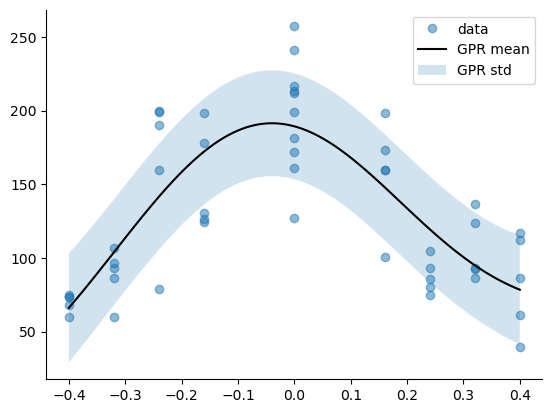

In [132]:
gpr_fit_results = gaussian_process_regression(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=True)

### Linear regression


In [209]:
from sklearn.linear_model import LinearRegression

def linear_regression_fitting(x, y, visualize=True):
    # Initialize and fit the linear regression model
    model = LinearRegression()
    model.fit(x.reshape(-1, 1), y)
    # Predict using the fitted model
    y_fit = model.predict(x.reshape(-1, 1))
    # Compute the explained variance (R^2 score)
    explained_variance = model.score(x.reshape(-1, 1), y)
    if visualize:
        plot_linear_regression_fit(x, y, model)
    
    return {
        "params": {
            "slope": model.coef_[0],
            "intercept": model.intercept_
        },
        "param_cov": None,  # Covariance matrix not available for simple linear regression
        "explained_variance": explained_variance
    }

def plot_linear_regression_fit(x, y, model):
    plt.plot(x, y, 'o', label='data', alpha=0.5)
    # Generate values for plotting the regression line
    x_fit = np.linspace(x.min(), x.max(), 100)
    y_fit = model.predict(x_fit.reshape(-1, 1))
    plt.plot(x_fit, y_fit, label='OLS fit', color="k")
    plt.legend()

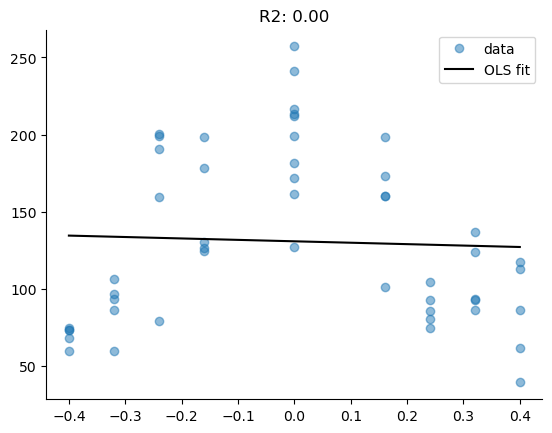

In [128]:
ols_fit_results = linear_regression_fitting(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=True)
plt.title(f"R2: {ols_fit_results['explained_variance']:.2f}")
plt.show()


### Gaussian curve fitting 

In [210]:
from scipy.optimize import curve_fit
# Define Gaussian function with baseline
def gaussian_with_baseline(x, amplitude, mean, stddev, baseline):
    return amplitude * np.exp(-((x - mean) ** 2) / (2 * stddev ** 2)) + baseline


def gaussian_curve_fitting(x, y, visualize=True, constrained=True):
    df_tmp = pd.DataFrame({"x": x, "y": y})
    df_tmp = df_tmp.groupby("x").agg({"y": ["mean", "std", "sem"]}).reset_index()
    x_uniq = df_tmp["x"]
    y_mean = df_tmp["y"]["mean"]
    y_std = df_tmp["y"]["std"]
    y_sem = df_tmp["y"]["sem"]
    # Initialize parameters
    x_range = np.max(x_uniq) - np.min(x_uniq)
    initial_amplitude = np.max(y_mean) - np.min(y_mean)
    initial_mean = x_uniq[np.argmax(y_mean)] # TODO: fix this, use the denoised / mean y data.
    initial_stddev = x_range / 4  # Arbitrary initial standard deviation
    initial_baseline = np.min(y_mean)

    initial_params = [initial_amplitude, initial_mean, initial_stddev, initial_baseline]
    if constrained:
        lower_bounds = [                 0.0,  np.min(x_uniq),         0.01,             0.0]
        upper_bounds = [1.25 * np.max(y_mean),  np.max(x_uniq),  x_range * 2,  np.max(y_mean)]
        bounds = (lower_bounds, upper_bounds)
    else:
        bounds = None
    # # Initialize parameters
    # initial_amplitude = np.max(y_mean) - np.min(y_mean)
    # initial_mean = x[np.argmax(y)] # TODO: fix this, use the denoised / mean y data.
    # initial_stddev = (np.max(x) - np.min(x)) / 4  # Arbitrary initial standard deviation
    # initial_baseline = np.min(y)

    # initial_params = [initial_amplitude, initial_mean, initial_stddev, initial_baseline]
    # if constrained:
    #     lower_bounds = [0.0,    np.min(x),  1e-6,   0.0]
    #     upper_bounds = [2 * np.max(y),  np.max(x),  (np.max(x) - np.min(x)) * 2,  1.5 * np.max(y)]
    #     bounds = (lower_bounds, upper_bounds)
    # else:
    #     bounds = None
    # Fit the curve with error handling
    try:
        params, param_cov = curve_fit(gaussian_with_baseline, x, y, p0=initial_params, bounds=bounds)
    except RuntimeError as e:
        print("Curve fitting failed:", e)
        params = None
        param_cov = None
    # compute the explained variance
    if params is not None:
        y_fit = gaussian_with_baseline(x, *params)
        explained_variance = 1 - np.var(y - y_fit) / np.var(y)
    else:
        explained_variance = None
    if visualize and params is not None:
        plot_gaussian_curve_fitting(x, y, params, )
    return {"params": params, 
            "param_cov": param_cov, 
            "explained_variance": explained_variance}


def plot_gaussian_curve_fitting(x, y, params,):
    plt.plot(x, y, 'o', label='data', alpha=0.5)
    # plot the mean y value per x value and error bars
    tmp_df = pd.DataFrame({"x": x, "y": y})
    tmp_df = tmp_df.groupby("x").agg({"y": ["mean", "std"]}).reset_index()
    plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', markersize=5, capsize=5, alpha=0.5)
    x_fit = np.linspace(x.min(), x.max(), 100)
    plt.plot(x_fit, gaussian_with_baseline(x_fit, *params), label='Gaussian curvefit', color="k")
    plt.legend()



C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\2992915867.py:46: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', markersize=5, capsize=5, alpha=0.5)


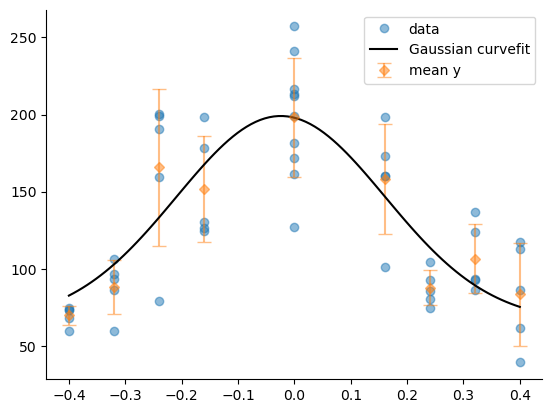

In [134]:
fit_results = gaussian_curve_fitting(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=True)
# plot_gaussian_curve_fitting(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, gauss_params, )

### Comparison across fitting methods

In [211]:
def regression_combined_plot(x_train, y_train, gauss_fit_results, ols_fit_results, gpr_fit_results, anova_results=None, title_str="", ax=None):
    if ax is None:
        fig, ax = plt.subplots()
    else:
        fig = ax.figure
    ax.plot(x_train, y_train, 'o', label='data', alpha=0.5)
    tmp_df = pd.DataFrame({"x": x_train, "y": y_train})
    tmp_df = tmp_df.groupby("x").agg({"y": ["mean", "std"]}).reset_index()
    ax.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5, linestyle="")
    x_eval = np.linspace(x_train.min(), x_train.max(), 100)
    gauss_params = gauss_fit_results["params"]
    ols_params = ols_fit_results["params"]
    gpr_kernel = gpr_fit_results["gpr"].kernel_
    gpr_kernel_str = str(gpr_kernel).replace("length_scale", "len").replace("noise_level", "noise").replace("RBF", "RBF").replace("WhiteKernel", "White")
    if gauss_params is not None:
        ax.plot(x_eval, gaussian_with_baseline(x_eval, *gauss_params), label='Gaussian curvefit', color="k")
    ax.plot(x_eval, ols_params["slope"] * x_eval + ols_params["intercept"], label='OLS fit', color="magenta", linestyle="--")
    ax.plot(gpr_fit_results["x_eval"], gpr_fit_results["y_mean"], label='GPR mean', color="red")
    ax.fill_between(
        gpr_fit_results["x_eval"],
        gpr_fit_results["y_mean"] - gpr_fit_results["y_std"],
        gpr_fit_results["y_mean"] + gpr_fit_results["y_std"],
        alpha=0.2,
        label="GPR std",
        color="red"
    )
    ax.legend()
    title_caption = ""
    if title_str:
        title_caption += f"{title_str}\n"
    if gauss_params is not None:
        title_caption += f"Gauss fit: Ampl.: {gauss_params[0]:.2f} Mean: {gauss_params[1]:.2f} Std: {gauss_params[2]:.2f} Bsl: {gauss_params[3]:.2f} [R2: {gauss_fit_results['explained_variance']:.2f}]\n"
    if ols_params is not None:
        title_caption += f"OLS fit: Slope: {ols_fit_results['params']['slope']:.2f} Intercept: {ols_fit_results['params']['intercept']:.2f} [R2: {ols_fit_results['explained_variance']:.2f}]\n"
    if gpr_fit_results is not None:
        title_caption += f"GPR fit: {gpr_kernel_str} [R2: {gpr_fit_results['explained_variance']:.2f}]"
    if anova_results is not None:
        title_caption += f"\nANOVA: {anova_results['stats_str']}"
    ax.set_title(title_caption)
    fig.tight_layout()
    return fig

In [222]:
def anova_test_df(df, x_col="lin_dist", y_col="pref_unit_resp"):
    anova_results = {}
    try:
        model = ols(f'{y_col} ~ C({x_col})', data=df).fit()
        anova_table = sm.stats.anova_lm(model, typ=2)
        F_value = anova_table.loc[f'C({x_col})', 'F']
        p_value = anova_table.loc[f'C({x_col})', 'PR(>F)']
        stats_str = f"F-val: {F_value:.2f} | p-val: {p_value:.1e}"
        anova_results["F_value"] = F_value
        anova_results["p_value"] = p_value
        anova_results["stats_str"] = stats_str
        anova_results["anova_table"] = anova_table
        anova_results["error"] = None
    except Exception as e:
        print(f"Error performing ANOVA : {e}")
        anova_results["F_value"] = np.nan
        anova_results["p_value"] = np.nan
        anova_results["stats_str"] = ""
        anova_results["anova_table"] = None
        anova_results["error"] = e
    return anova_results

Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21
Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20
Adding origin trials for noise 30
Adding origin trials for noise 40


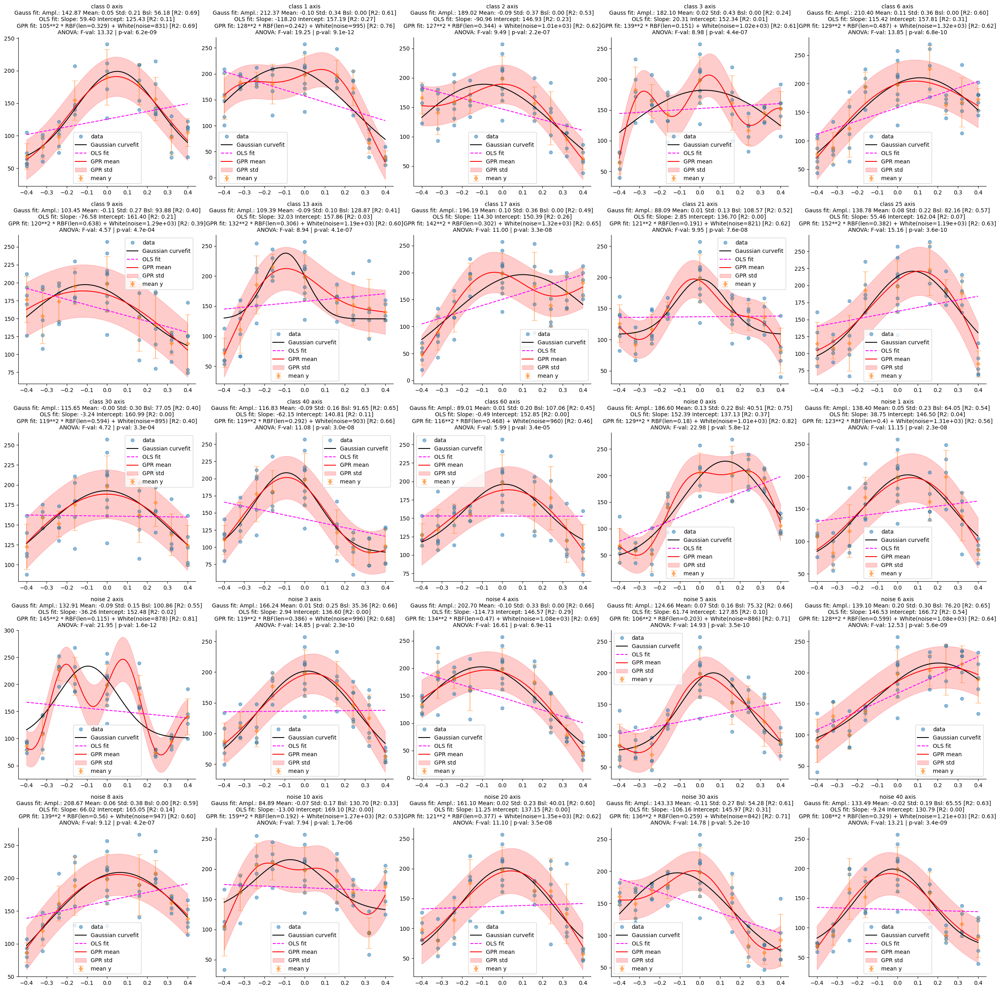

In [207]:
figroot = f"E:\OneDrive - Harvard University\BigGAN_Hessian"
figdir = join(figroot, "Beto-07092020-003")
os.makedirs(figdir, exist_ok=True)
sgtr_resp_df = pd.read_csv(join(figdir, f"single_trial_pref_unit_resp.csv"))
sgtr_resp_at_origin = sgtr_resp_df.query(f"lin_dist == 0.0") # if some axis does not have origin stats, add it. 
axis_count = sgtr_resp_df[['space_name', 'eig_id']].drop_duplicates().shape[0]
ncols = 5
nrows = math.ceil(axis_count / ncols)
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 5, nrows * 5))
ax_idx = 0
for ((space, eig_id), sgtr_resp_per_axis), ax in zip(sgtr_resp_df.groupby(['space_name', 'eig_id'], sort=True), axs.flatten()):
    if 0.0 not in sgtr_resp_per_axis["lin_dist"].unique():
        print(f"Adding origin trials for {space} {eig_id}")
        sgtr_resp_per_axis = pd.concat([sgtr_resp_per_axis, sgtr_resp_at_origin])
    gauss_fit_results = gaussian_curve_fitting(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=False)
    ols_fit_results = linear_regression_fitting(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=False)
    gpr_fit_results = gaussian_process_regression(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=False)
    anova_results = anova_test_df(sgtr_resp_per_axis, x_col="lin_dist", y_col="pref_unit_resp")
    regression_combined_plot(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, gauss_fit_results, ols_fit_results, gpr_fit_results, 
                               anova_results=anova_results, title_str=f"{space} {eig_id} axis", ax=ax)
    # change the title font size
    ax.set_title(ax.get_title(), fontsize=10)
    ax_idx += 1
# remove the extra axes 
for ax in axs.flatten()[ax_idx:]:
    ax.remove()
plt.tight_layout()
plt.show()

C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

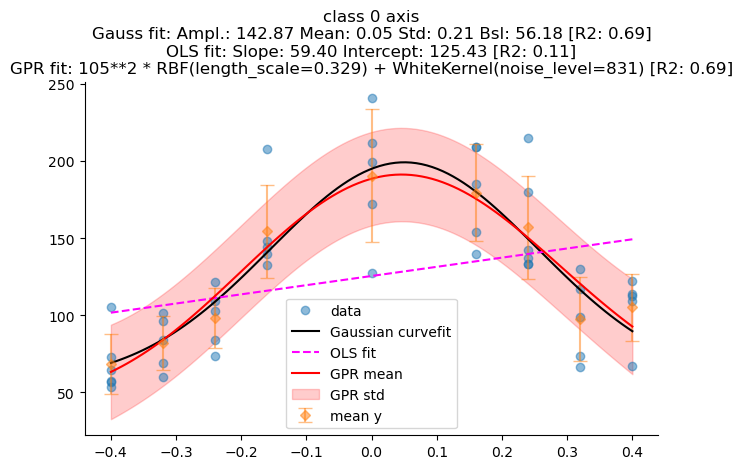

Adding origin trials for class 1


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

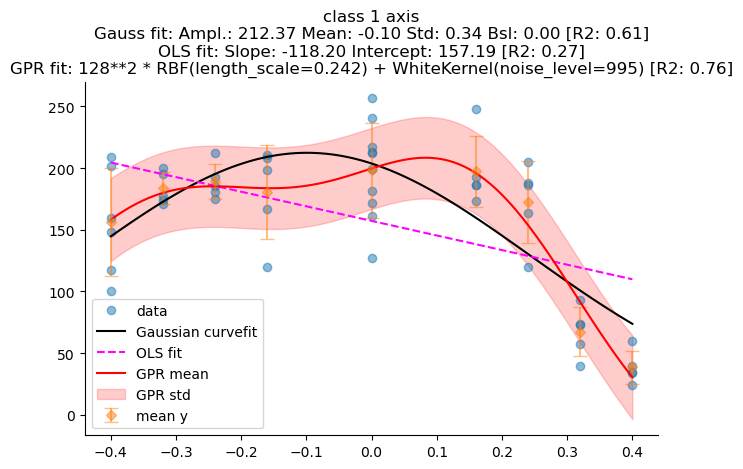

Adding origin trials for class 2


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

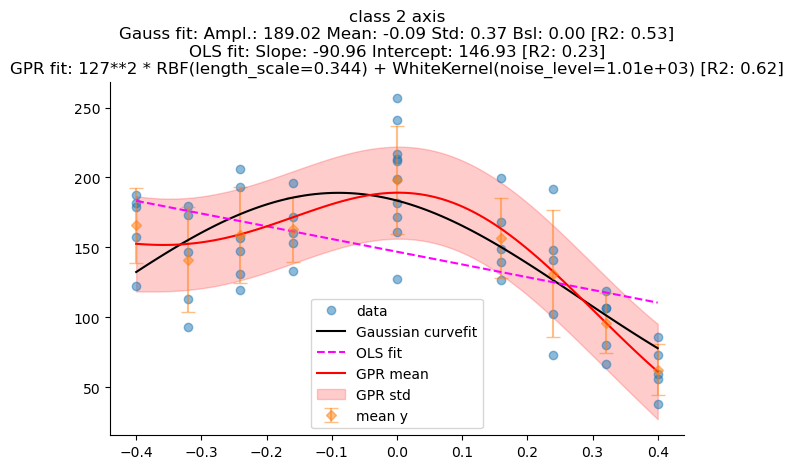

Adding origin trials for class 3


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

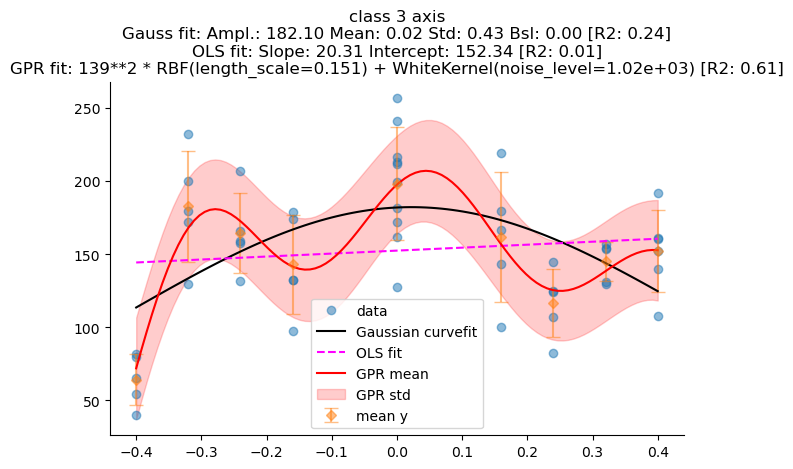

Adding origin trials for class 6


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

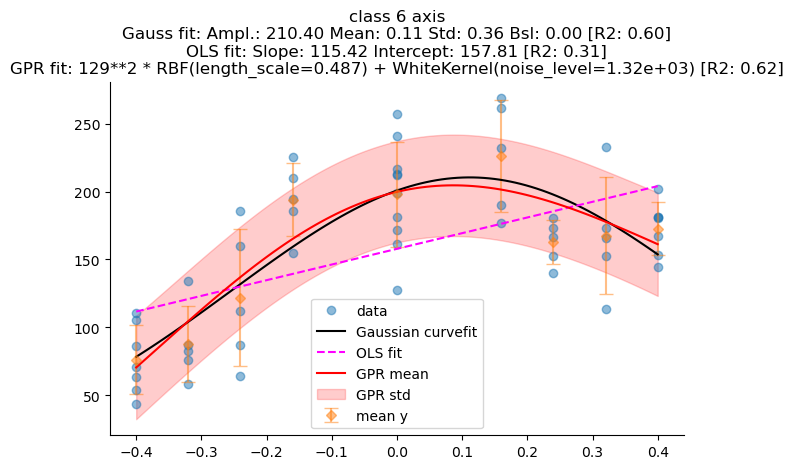

Adding origin trials for class 9


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

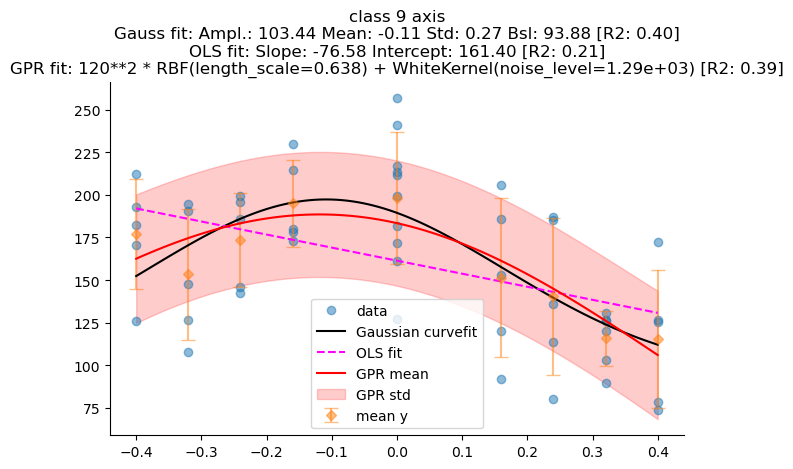

Adding origin trials for class 13


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

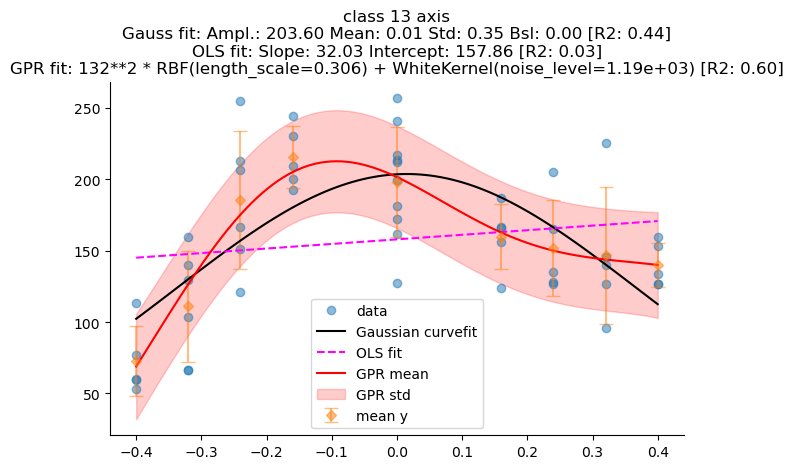

Adding origin trials for class 17


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

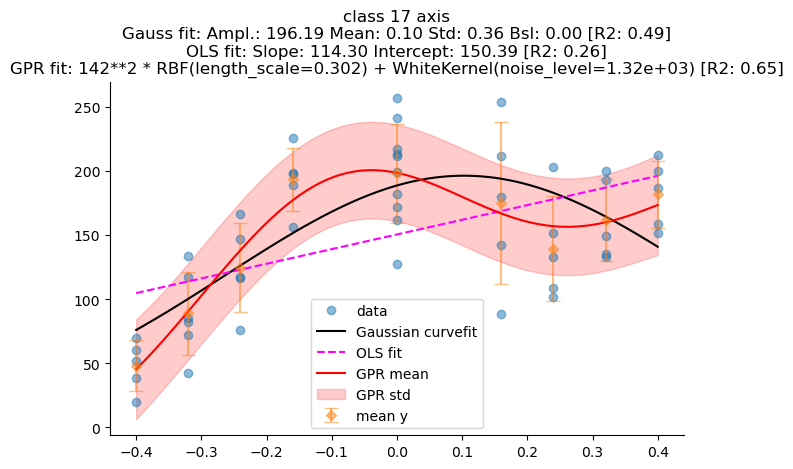

Adding origin trials for class 21


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

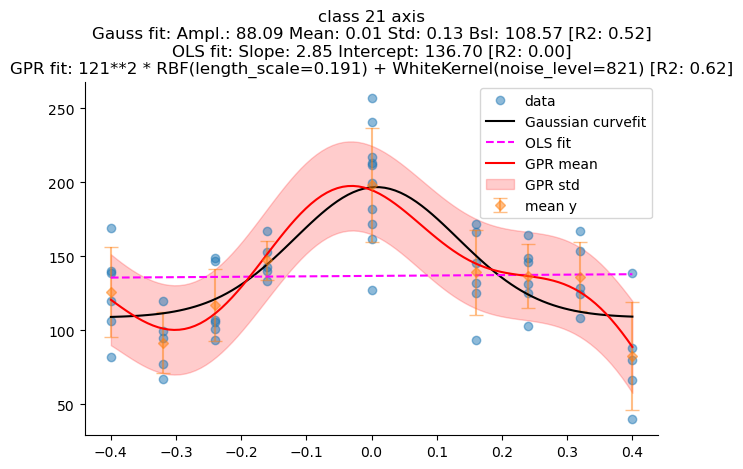

Adding origin trials for class 25


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

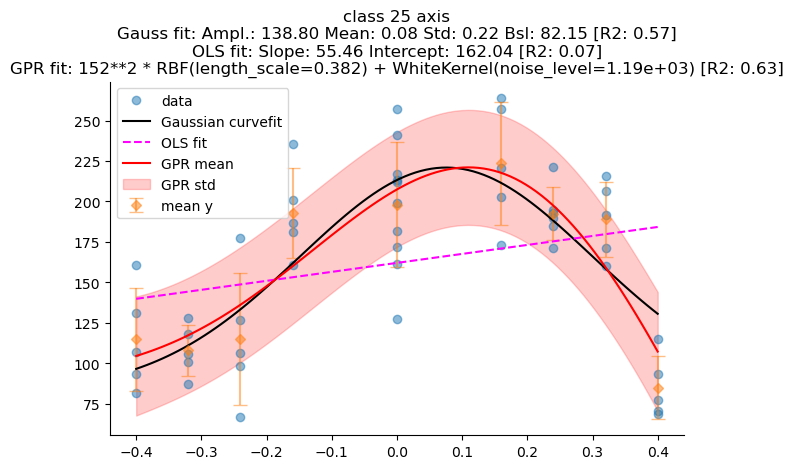

Adding origin trials for class 30


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

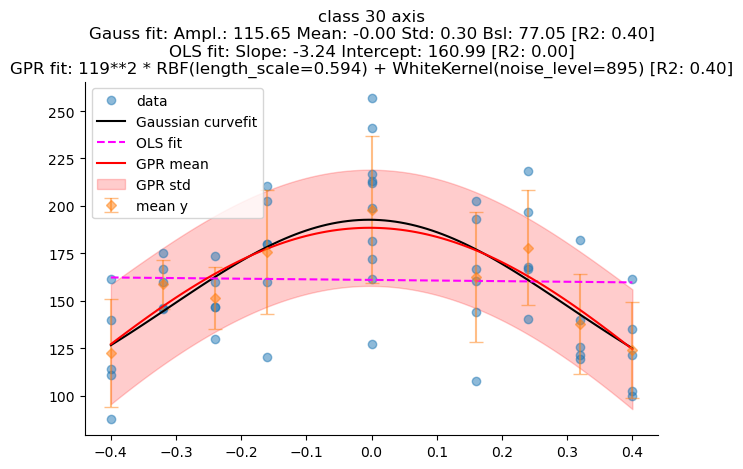

Adding origin trials for class 40


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

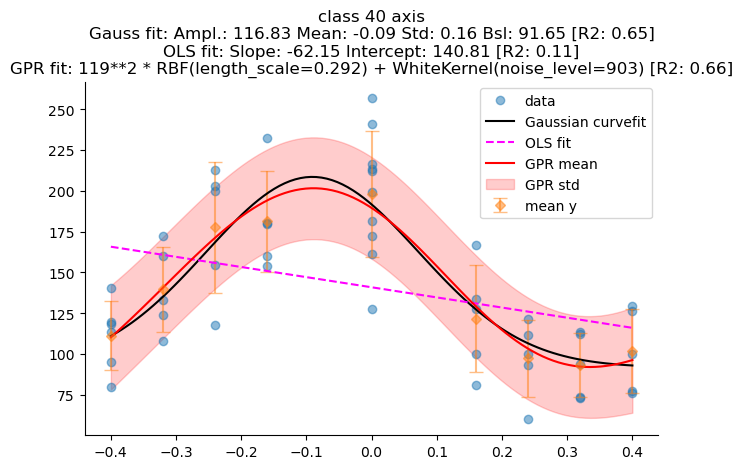

Adding origin trials for class 60


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

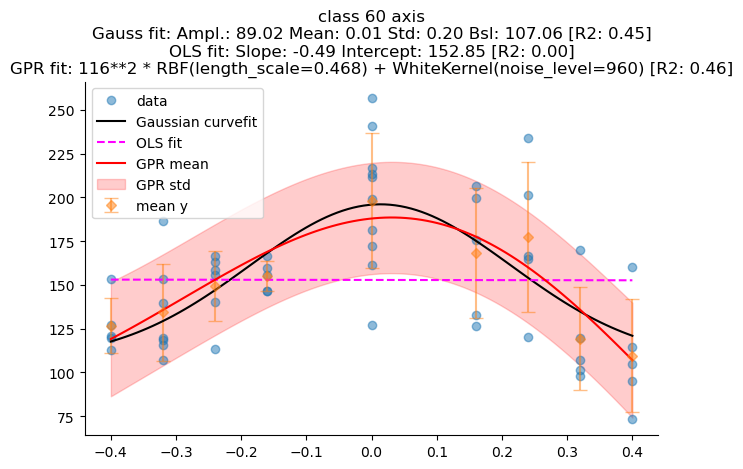

C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

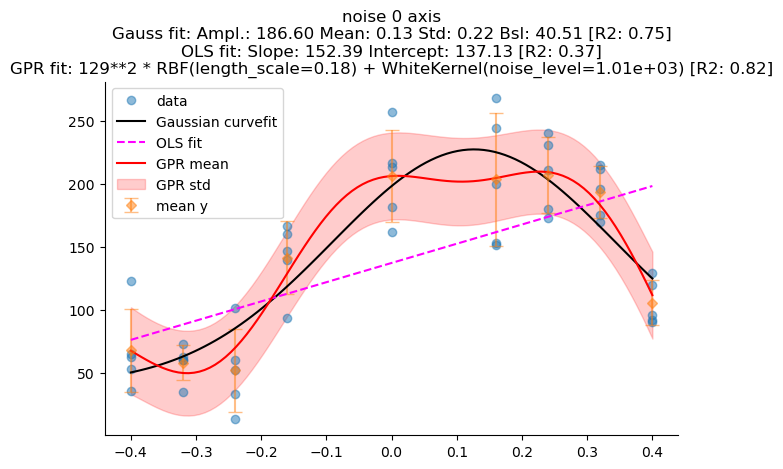

Adding origin trials for noise 1


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

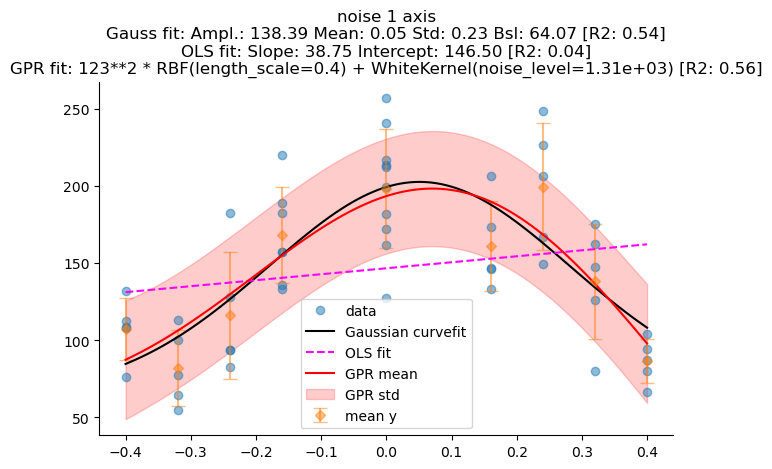

Adding origin trials for noise 2


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

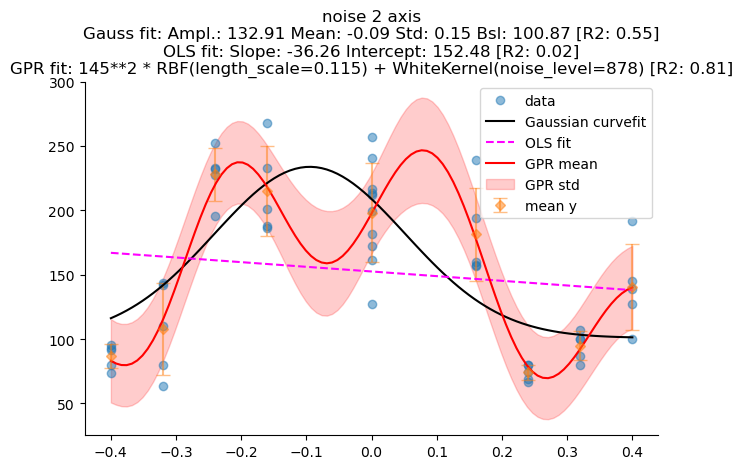

Adding origin trials for noise 3


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

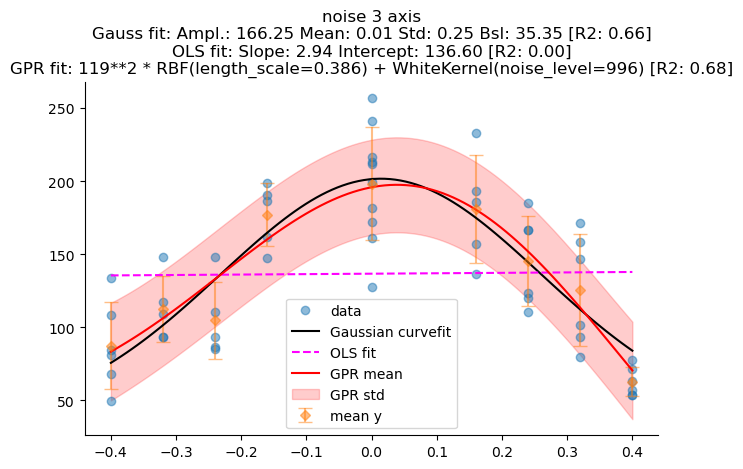

Adding origin trials for noise 4


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

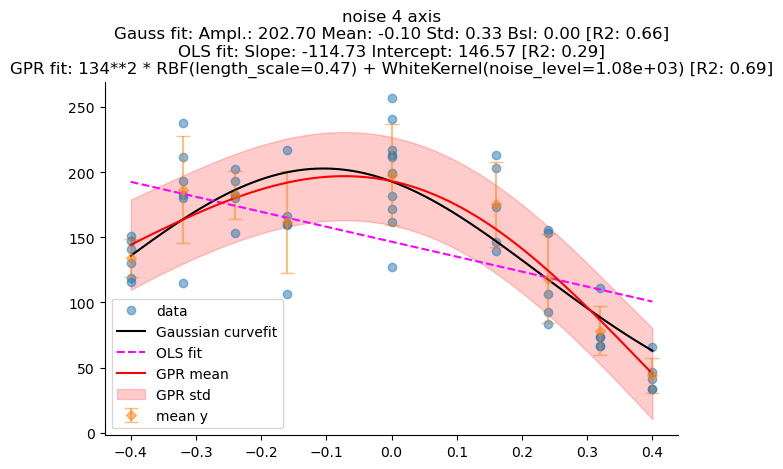

Adding origin trials for noise 5


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

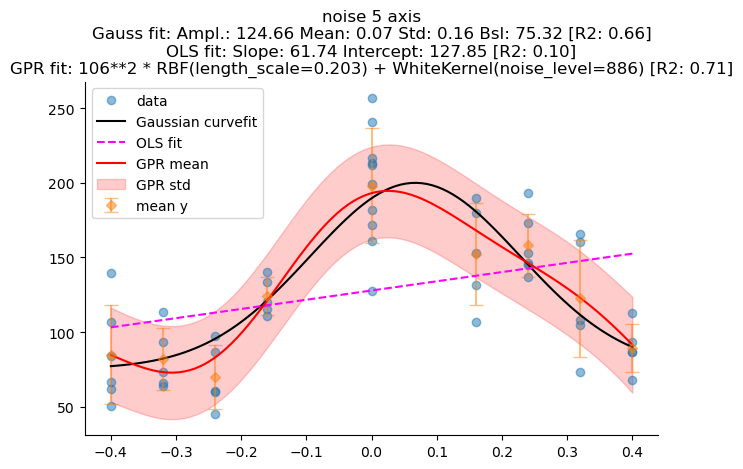

Adding origin trials for noise 6


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

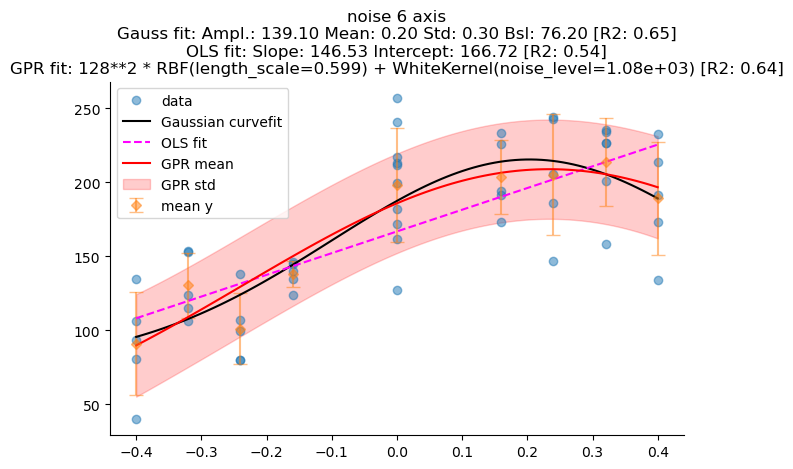

Adding origin trials for noise 8


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

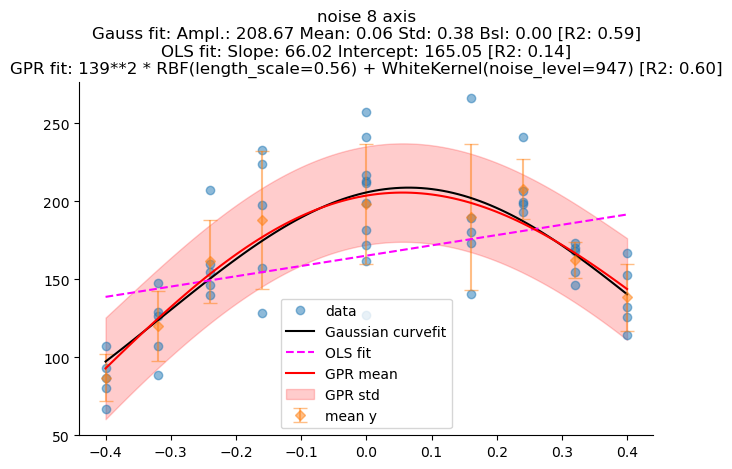

Adding origin trials for noise 10


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

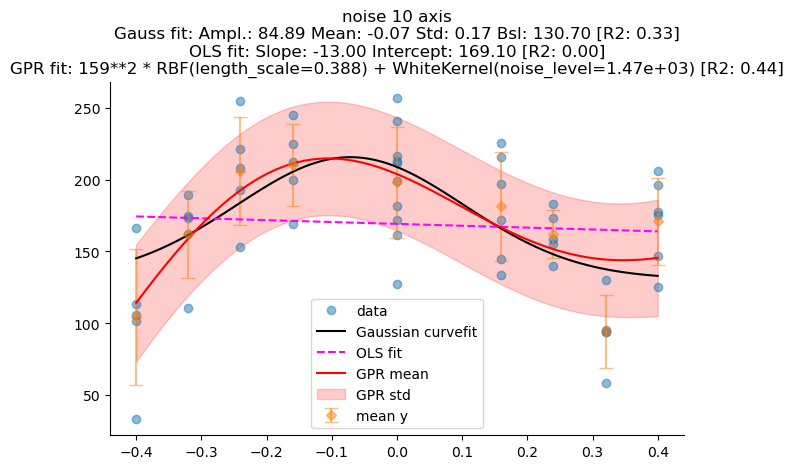

Adding origin trials for noise 20


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

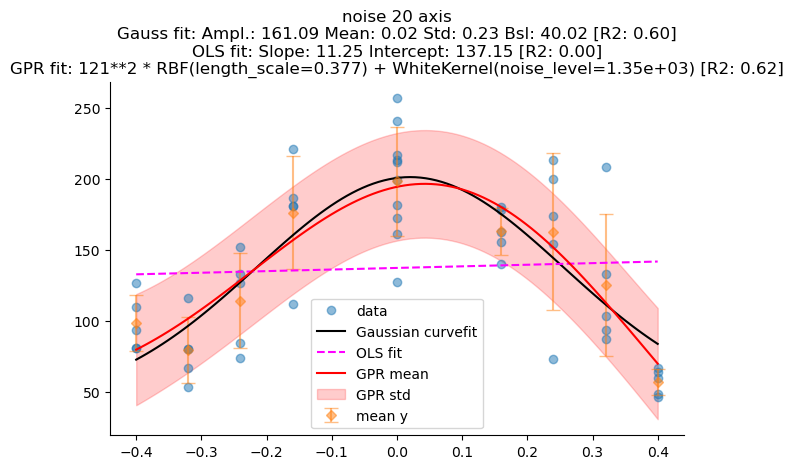

Adding origin trials for noise 30


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

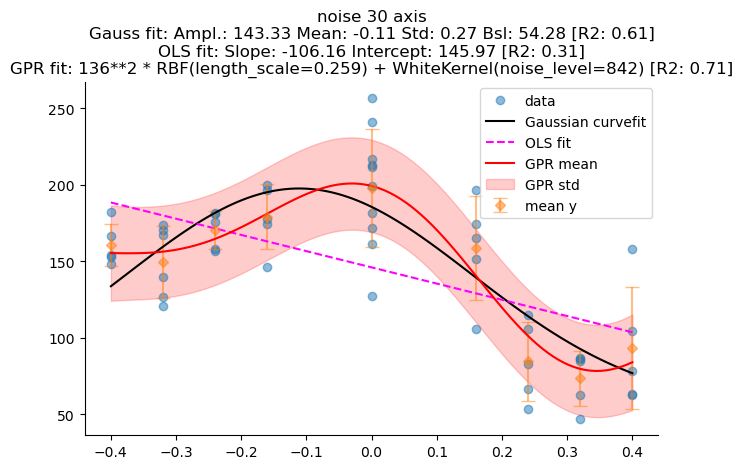

Adding origin trials for noise 40


C:\Users\ponce\AppData\Local\Temp\ipykernel_71756\527544486.py:6: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "D" (-> marker='D'). The keyword argument will take precedence.
  plt.errorbar(tmp_df["x"], tmp_df["y"]["mean"], yerr=tmp_df["y"]["std"], fmt='D', label='mean y', marker='D', color="C1", markersize=5, capsize=5, alpha=0.5)


<Figure size 640x480 with 0 Axes>

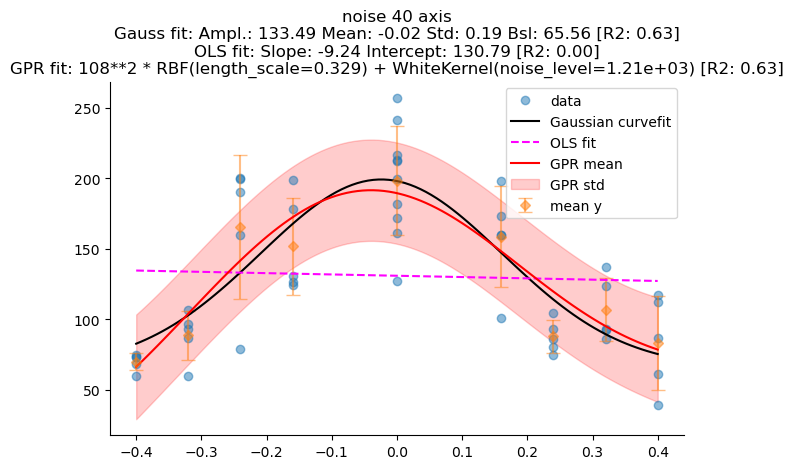

In [169]:
figroot = f"E:\OneDrive - Harvard University\BigGAN_Hessian"
figdir = join(figroot, "Beto-07092020-003")
os.makedirs(figdir, exist_ok=True)
sgtr_resp_df = pd.read_csv(join(figdir, f"single_trial_pref_unit_resp.csv"))
sgtr_resp_at_origin = sgtr_resp_df.query(f"lin_dist == 0.0") # if some axis does not have origin stats, add it. 
for space in ["class", "noise"]:
    unique_eig_ids = sgtr_resp_df.query(f"space_name == '{space}'")["eig_id"].unique()
    unique_eig_ids = sorted(unique_eig_ids)
    for eig_id in unique_eig_ids:
        sgtr_resp_per_axis = sgtr_resp_df.query(f"space_name == '{space}' and eig_id == {eig_id}")
        if 0.0 not in sgtr_resp_per_axis["lin_dist"].unique():
            print(f"Adding origin trials for {space} {eig_id}")
            sgtr_resp_per_axis = pd.concat([sgtr_resp_per_axis, sgtr_resp_at_origin])
        plt.figure()
        gauss_fit_results = gaussian_curve_fitting(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=False)
        ols_fit_results = linear_regression_fitting(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=False)
        gpr_fit_results = gaussian_process_regression(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, visualize=False)
        regression_combined_plot(sgtr_resp_per_axis["lin_dist"].values, sgtr_resp_per_axis["pref_unit_resp"].values, gauss_fit_results, ols_fit_results, gpr_fit_results, 
                                 title_str=f"{space} {eig_id} axis")
        plt.tight_layout()
        plt.show()

### Mass analysis

In [215]:
rowi

1

0it [00:00, ?it/s]

Processing: row 33 Alfa-13012021-003 Alfa 19.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\statsmodels\regression\linear_model.py:1716: RuntimeWarning: divide by zero encountered in scalar divide
  return np.dot(wresid, wresid) / self.df_resid


Error performing ANOVA : r_matrix performs f_test for using dimensions that are asymptotically non-normal
Adding origin trials for class 1


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 21


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 25
Adding origin trials for class 30
Curve fitting failed: Optimal parameters not found: The maximum number of function evaluations is exceeded.
Adding origin trials for class 40
Adding origin trials for class 60


c:\Users\ponce\.conda\envs\torch\lib\site-packages\statsmodels\regression\linear_model.py:1716: RuntimeWarning: divide by zero encountered in scalar divide
  return np.dot(wresid, wresid) / self.df_resid


Error performing ANOVA : r_matrix performs f_test for using dimensions that are asymptotically non-normal
Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 8


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 10
Adding origin trials for noise 20


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 30
Adding origin trials for noise 40


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


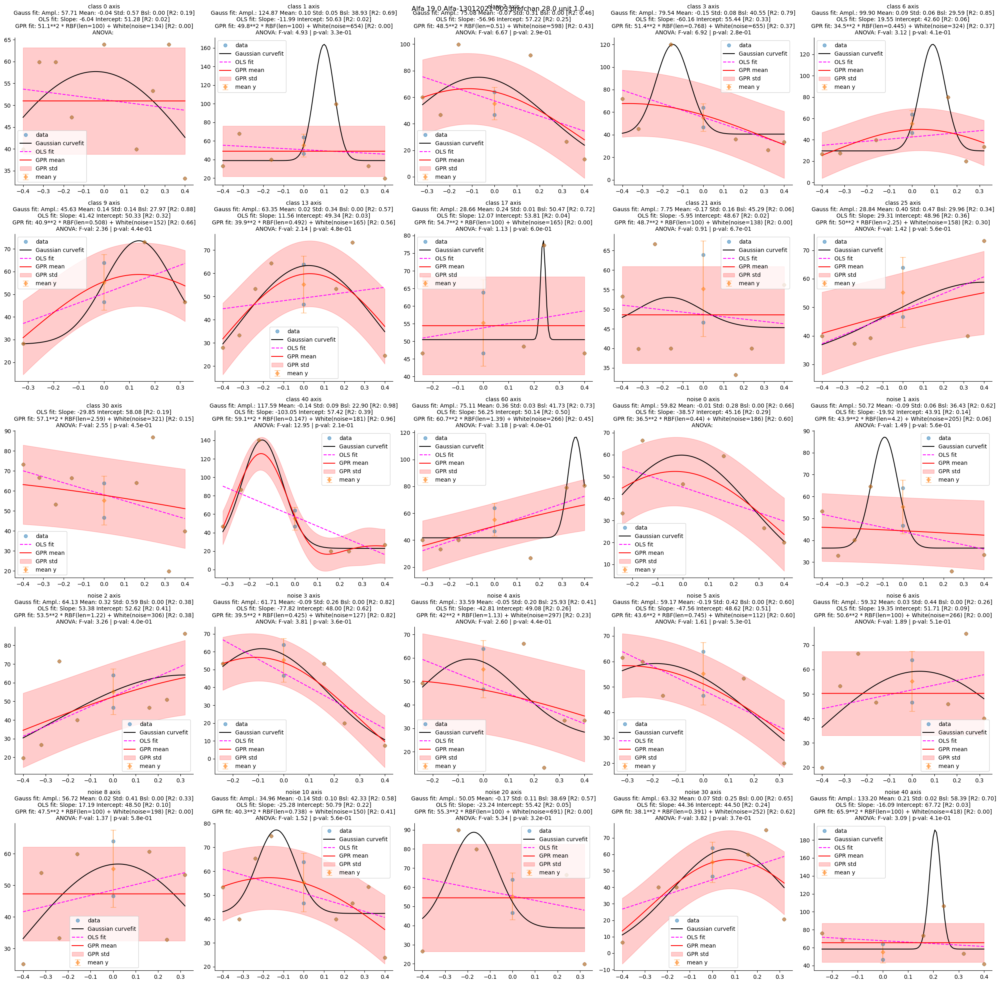

34it [00:36,  1.08s/it]

Processing: row 34 Alfa-19022021-004 Alfa 20.0
Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21
Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 0
Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20
Adding origin trials for noise 30
Adding origin trials for noise 40


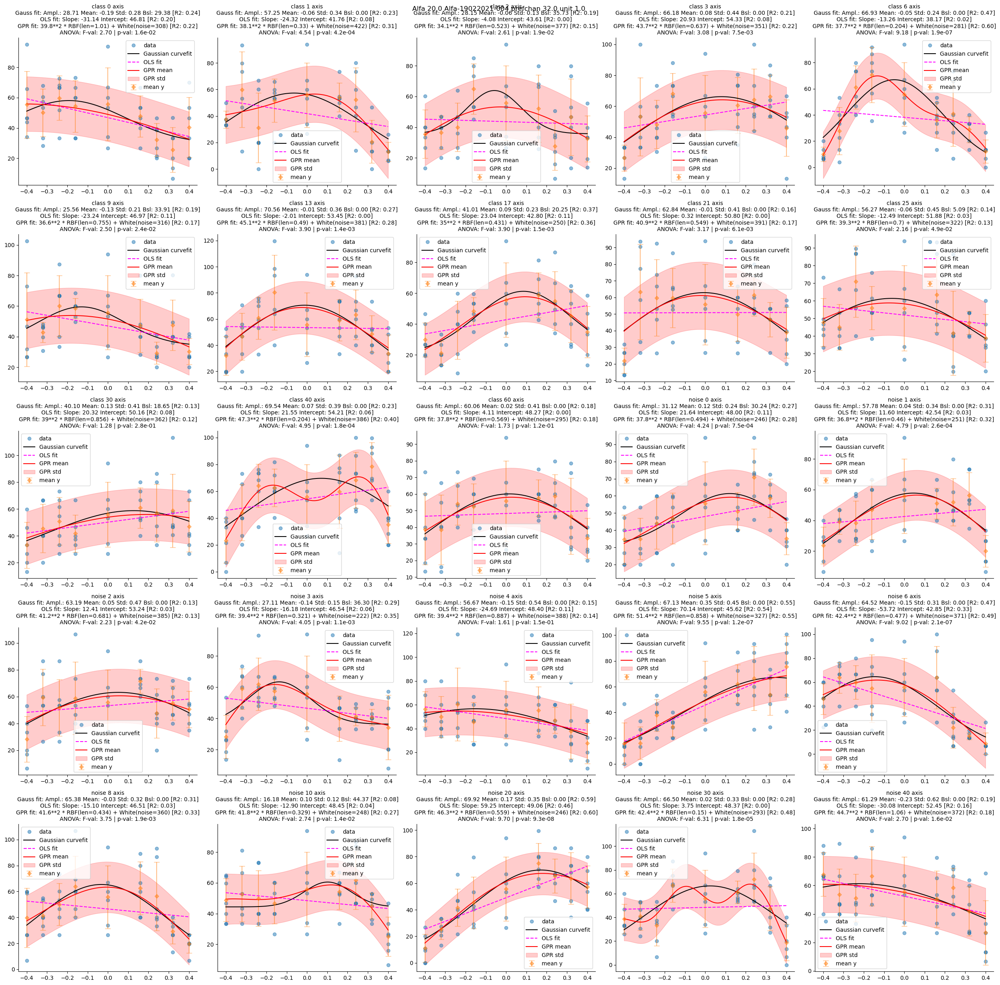

35it [01:15,  2.61s/it]

Processing: row 35 Alfa-25022021-004 Alfa 21.0
Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 9


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 13
Adding origin trials for class 17


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 21


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 25


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 30
Adding origin trials for class 40


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 60


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 5


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20
Adding origin trials for noise 30


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 40


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


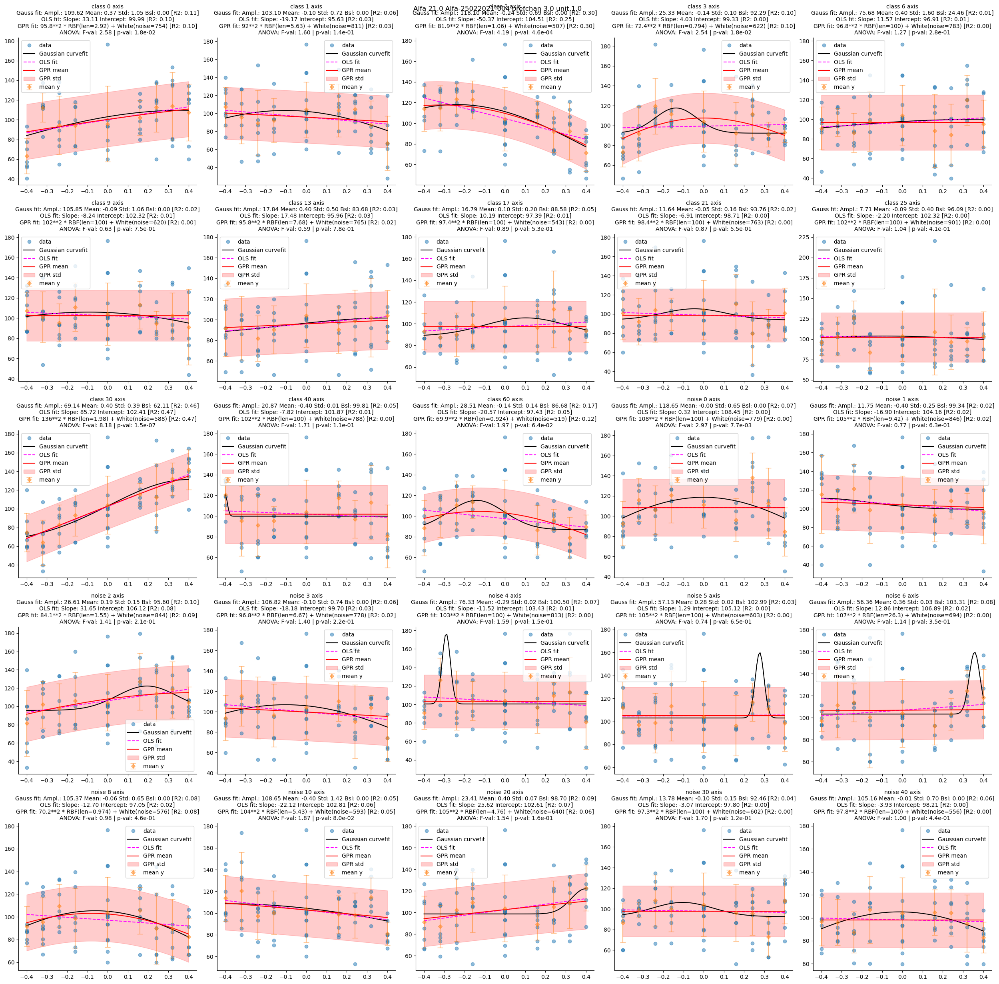

36it [01:56,  4.68s/it]

Processing: row 36 Alfa-26022021-005 Alfa 22.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 1


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 2
Curve fitting failed: Optimal parameters not found: The maximum number of function evaluations is exceeded.


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 3


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 6


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 9


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21
Curve fitting failed: Optimal parameters not found: The maximum number of function evaluations is exceeded.


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 60
Curve fitting failed: Optimal parameters not found: The maximum number of function evaluations is exceeded.


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 10


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 20


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 30
Adding origin trials for noise 40


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


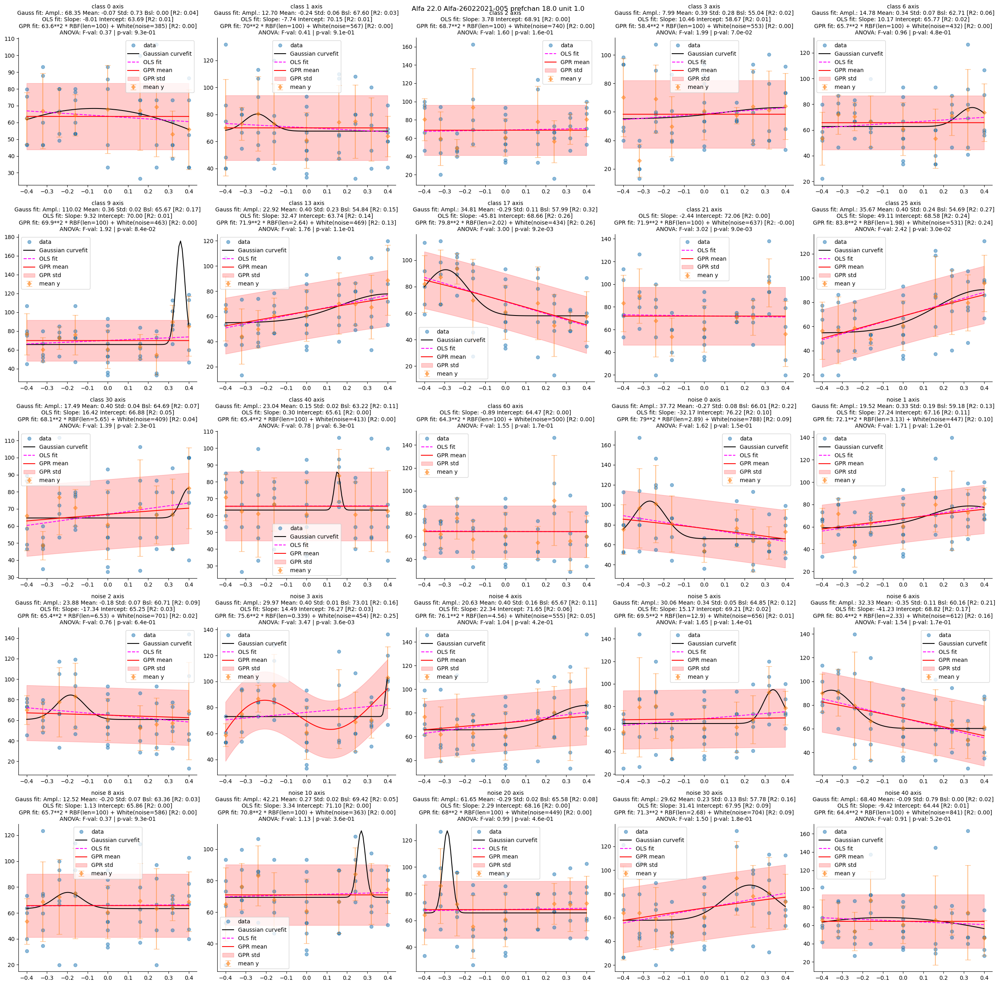

37it [02:35,  7.15s/it]

Processing: row 37 Alfa-12032021-005 Alfa 23.0
Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21
Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20
Adding origin trials for noise 30
Adding origin trials for noise 40


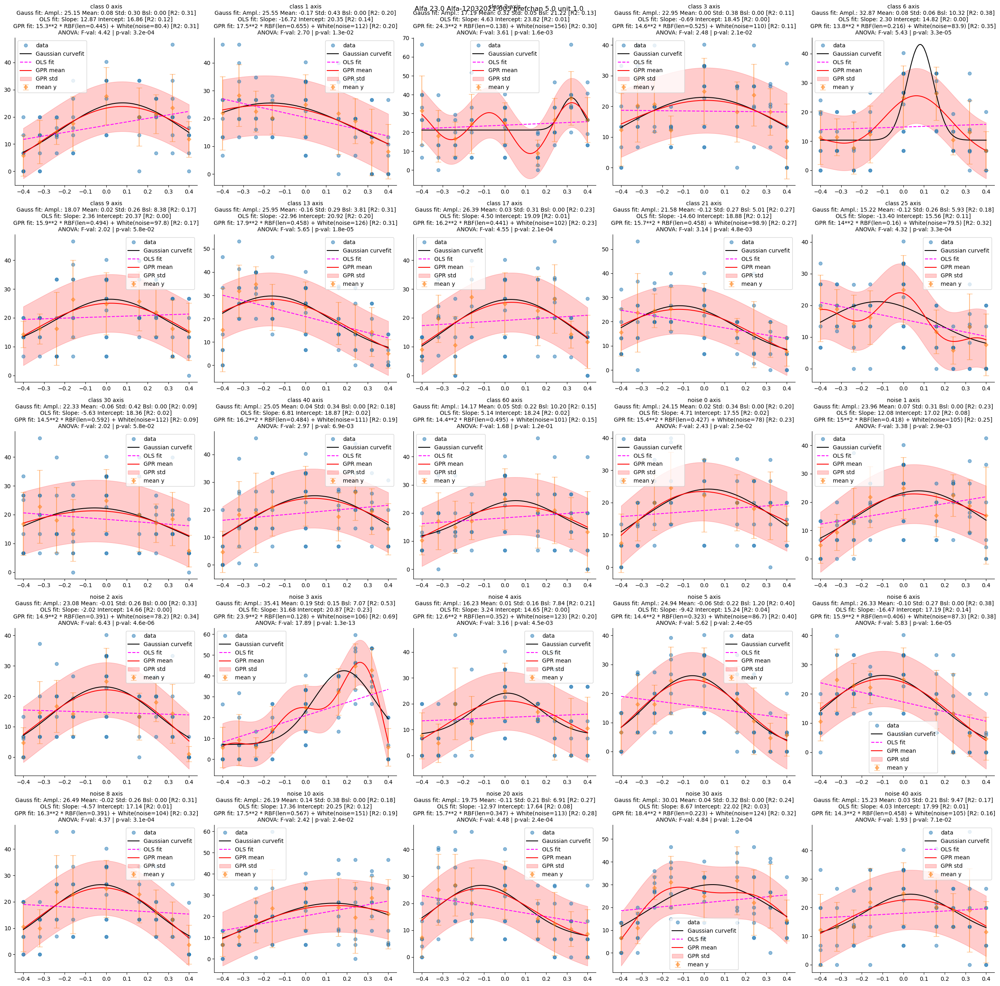

38it [03:14, 10.17s/it]

Processing: row 38 Alfa-01042021-004 Alfa 24.0
Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 21


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1
Adding origin trials for noise 2


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20
Adding origin trials for noise 30
Adding origin trials for noise 40


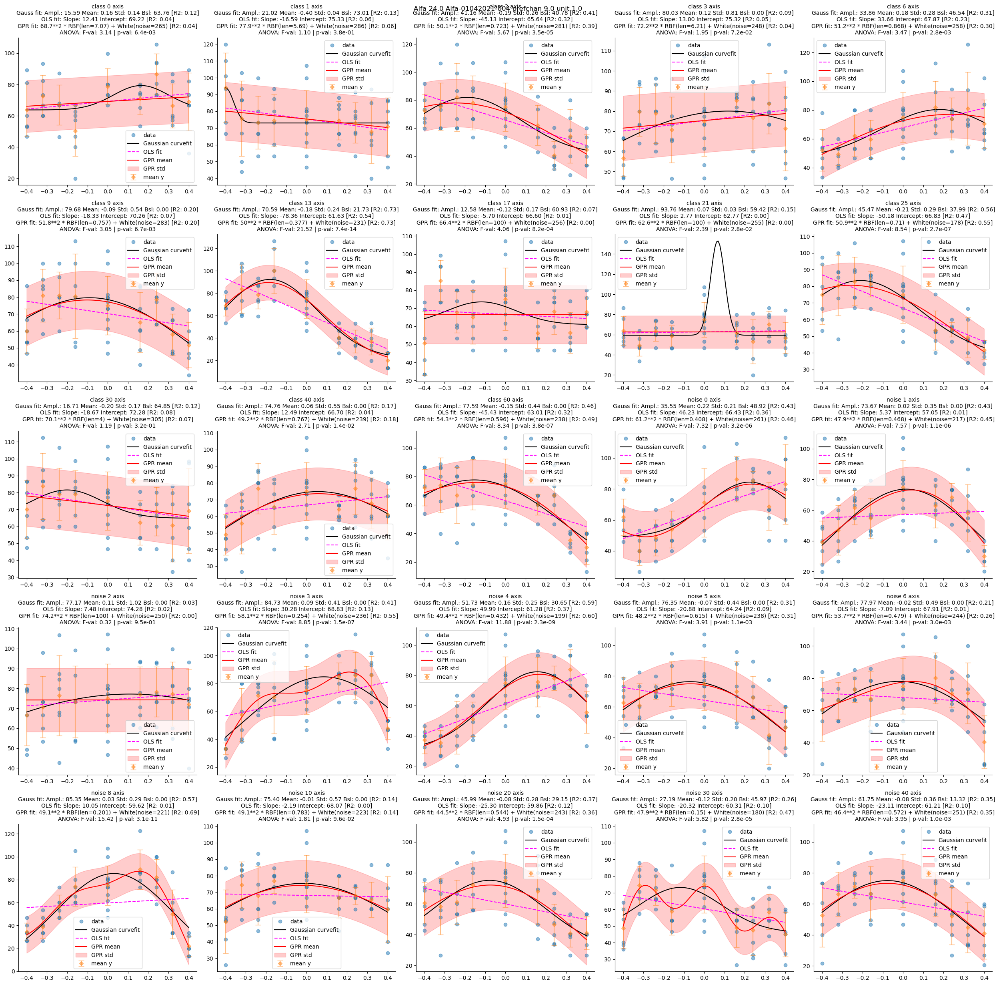

39it [03:54, 13.63s/it]

Processing: row 39 Alfa-08042021-003 Alfa 25.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21
Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20
Adding origin trials for noise 30
Adding origin trials for noise 40


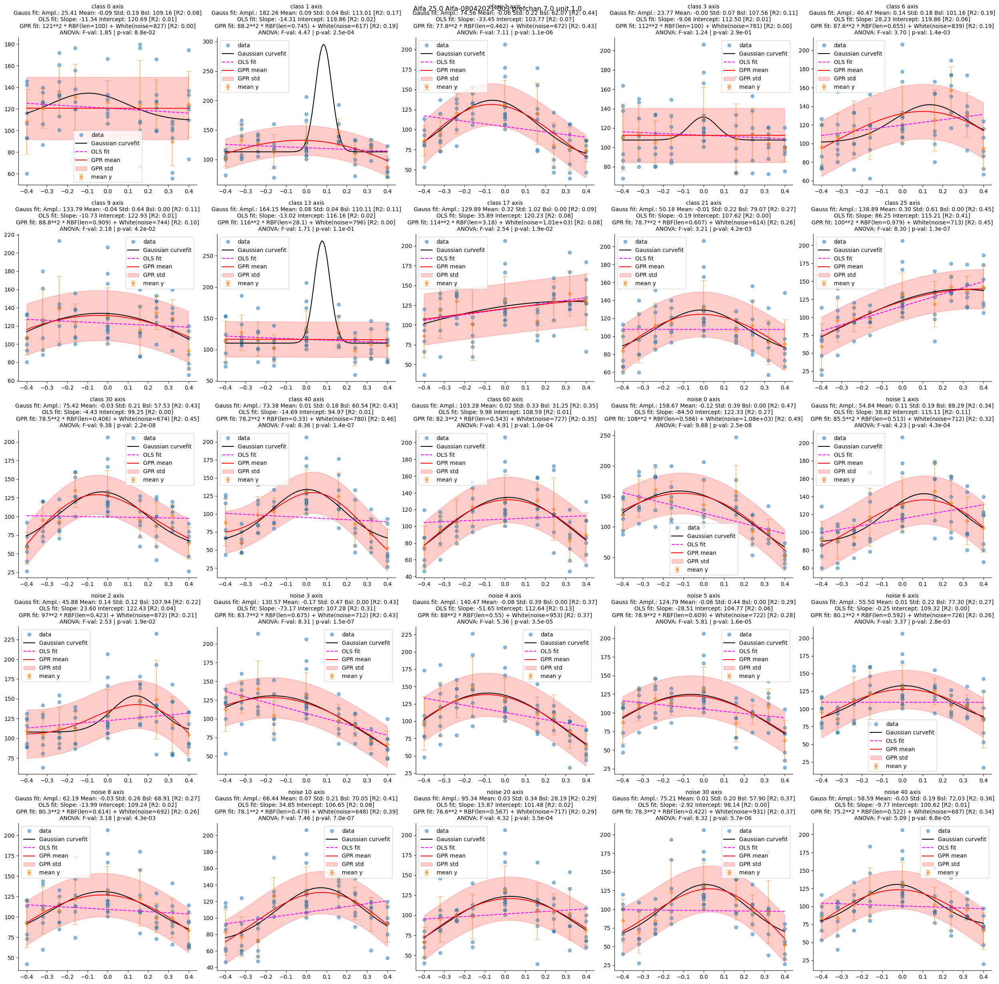

40it [04:34, 17.44s/it]

Processing: row 40 Alfa-14052021-004 Alfa 26.0
Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 13


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 17
Adding origin trials for class 21
Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 30


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 40


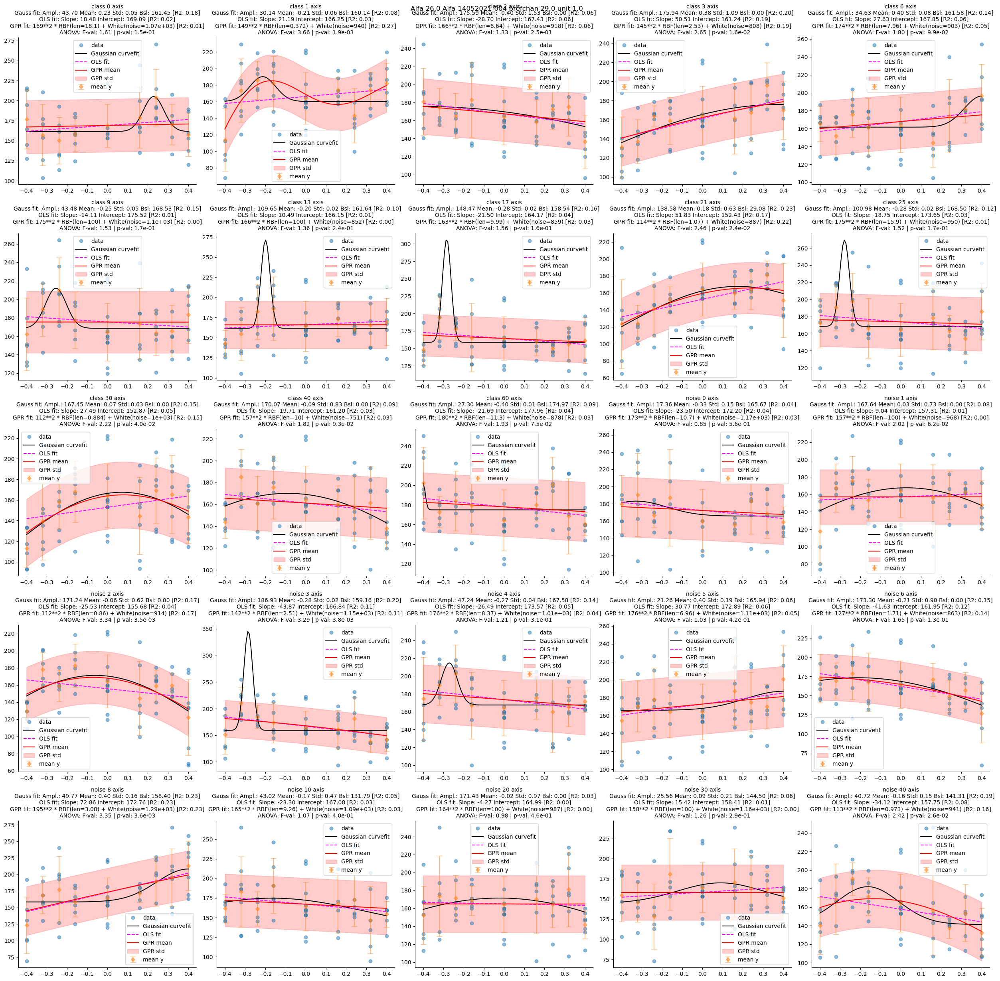

41it [05:14, 21.37s/it]

Processing: row 41 Beto-27072020-004 Beto 1.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

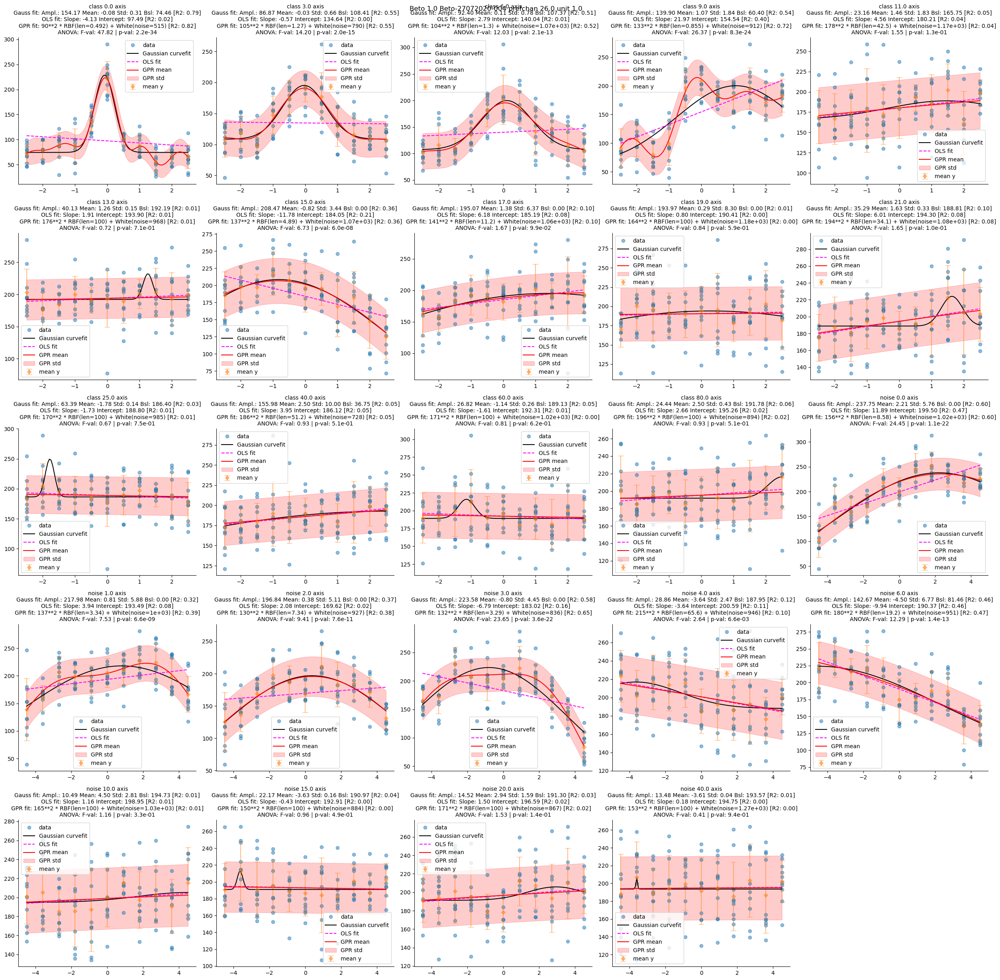

42it [05:52, 24.56s/it]

Processing: row 42 Beto-05082020-003 Beto 2.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

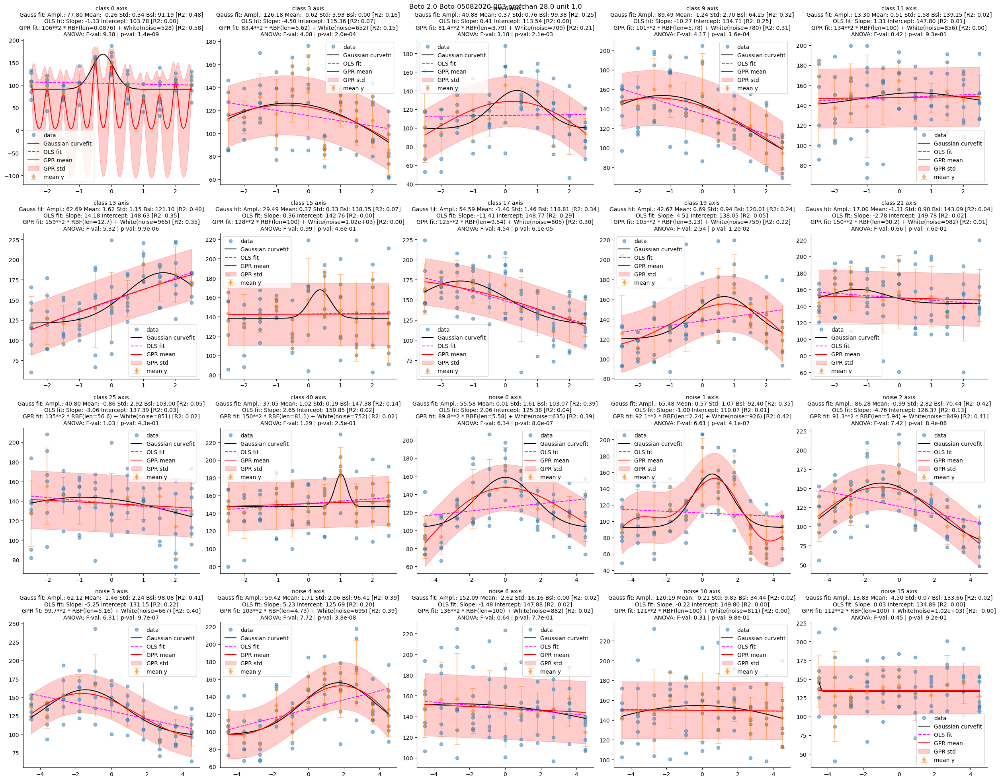

43it [06:20, 25.39s/it]

Processing: row 43 Beto-07082020-003 Beto 3.0


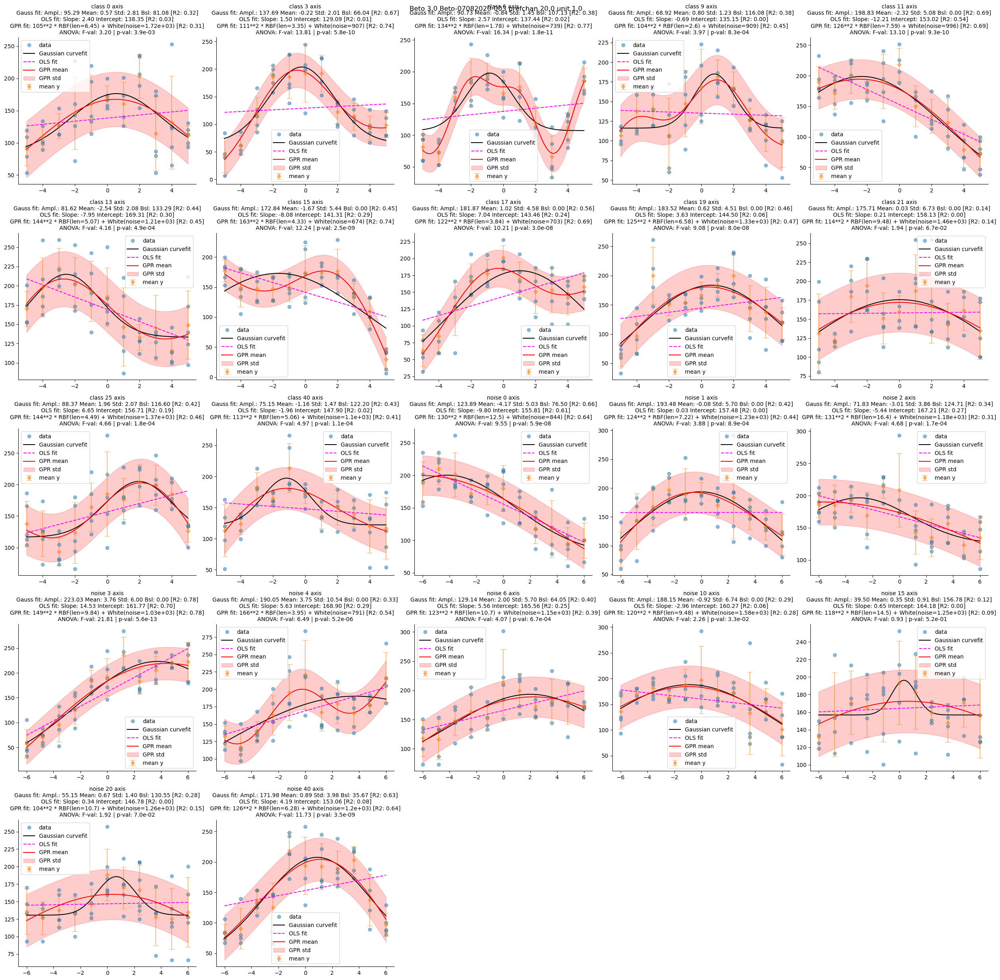

44it [06:51, 26.63s/it]

Processing: row 44 Beto-11082020-004 Beto 4.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

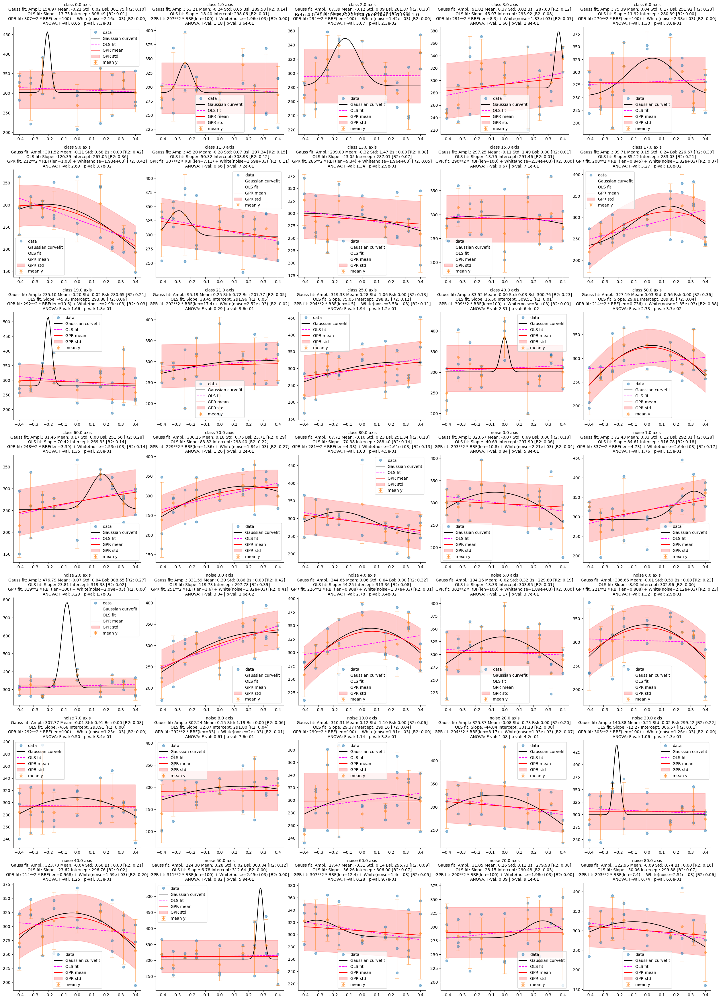

45it [07:53, 35.55s/it]

Processing: row 45 Beto-13082020-004 Beto 5.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

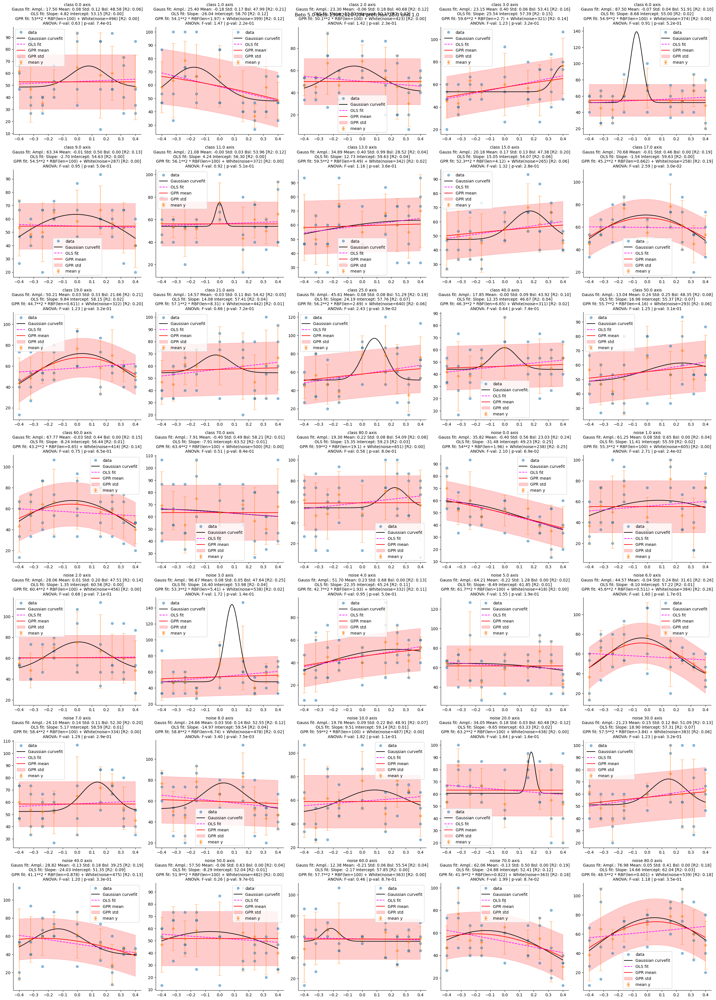

46it [08:55, 42.72s/it]

Processing: row 46 Beto-17082020-004 Beto 6.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

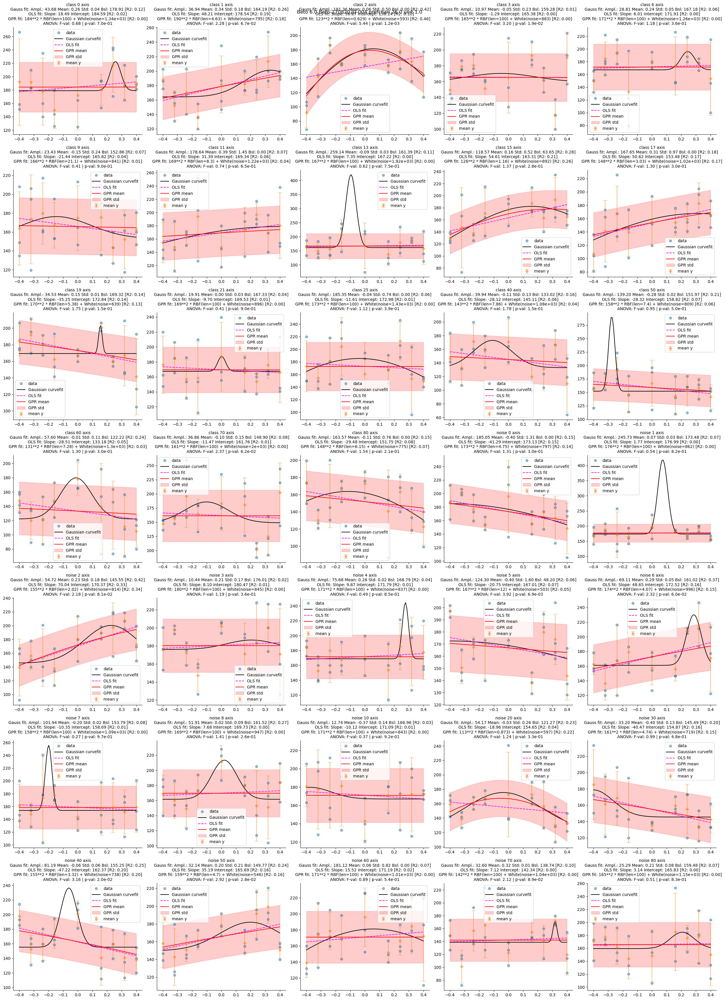

47it [09:56, 47.67s/it]

Processing: row 47 Beto-18082020-003 Beto 7.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 25


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 2


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 3
Adding origin trials for noise 4


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 5


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 30
Adding origin trials for noise 40


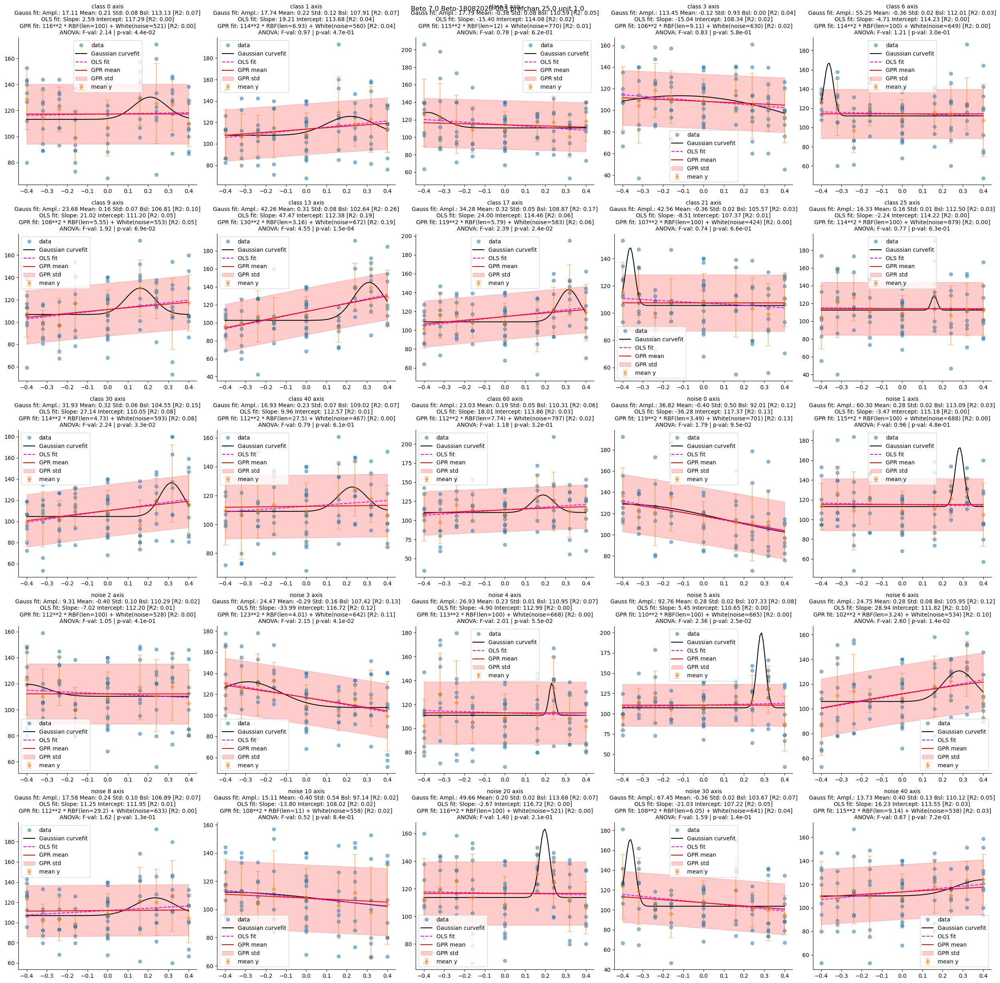

48it [10:37, 45.81s/it]

Processing: row 48 Beto-20082020-004 Beto 8.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

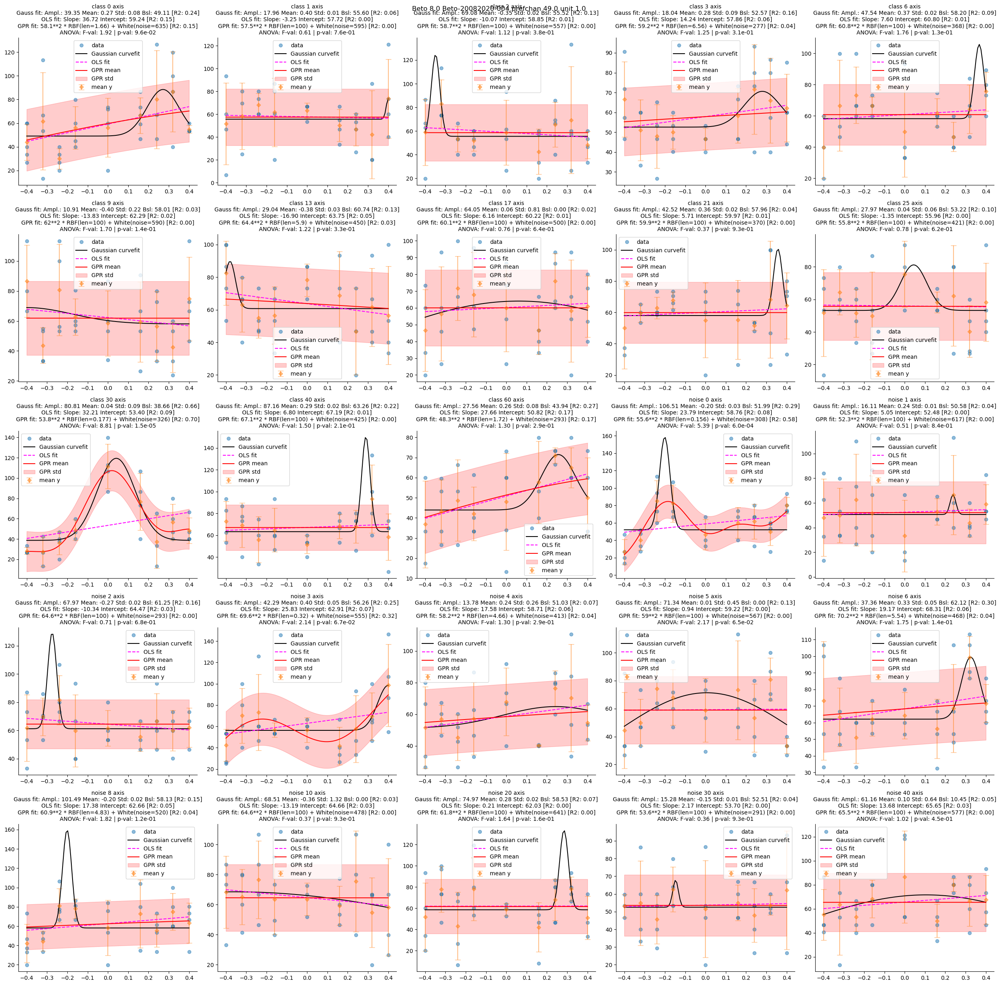

49it [11:15, 43.55s/it]

Processing: row 49 Beto-24082020-003 Beto 9.0
Adding origin trials for class 1


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21
Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 20
Adding origin trials for noise 30
Adding origin trials for noise 40


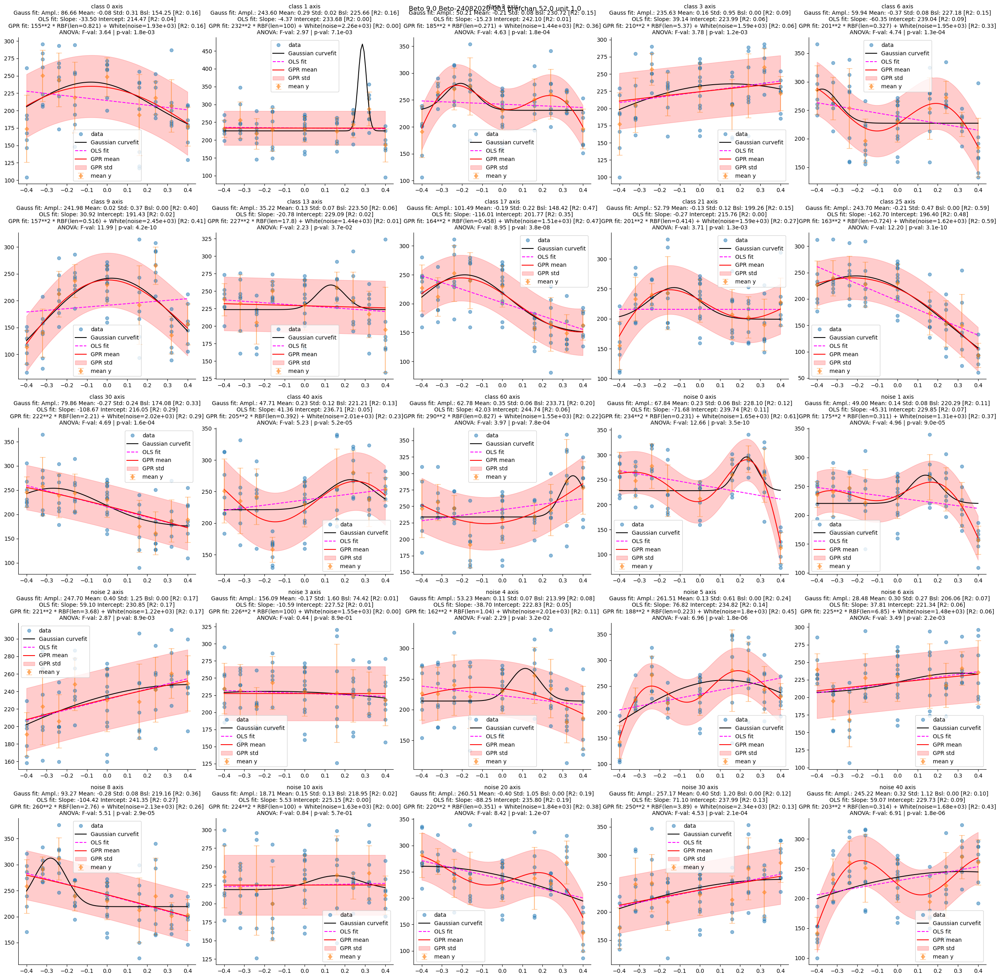

50it [11:55, 42.58s/it]

Processing: row 50 Beto-31082020-003 Beto 10.0
Adding origin trials for class 1


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 13


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 17


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 21


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 25


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 2
Adding origin trials for noise 3


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 4


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 10


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 20
Adding origin trials for noise 30


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


Adding origin trials for noise 40


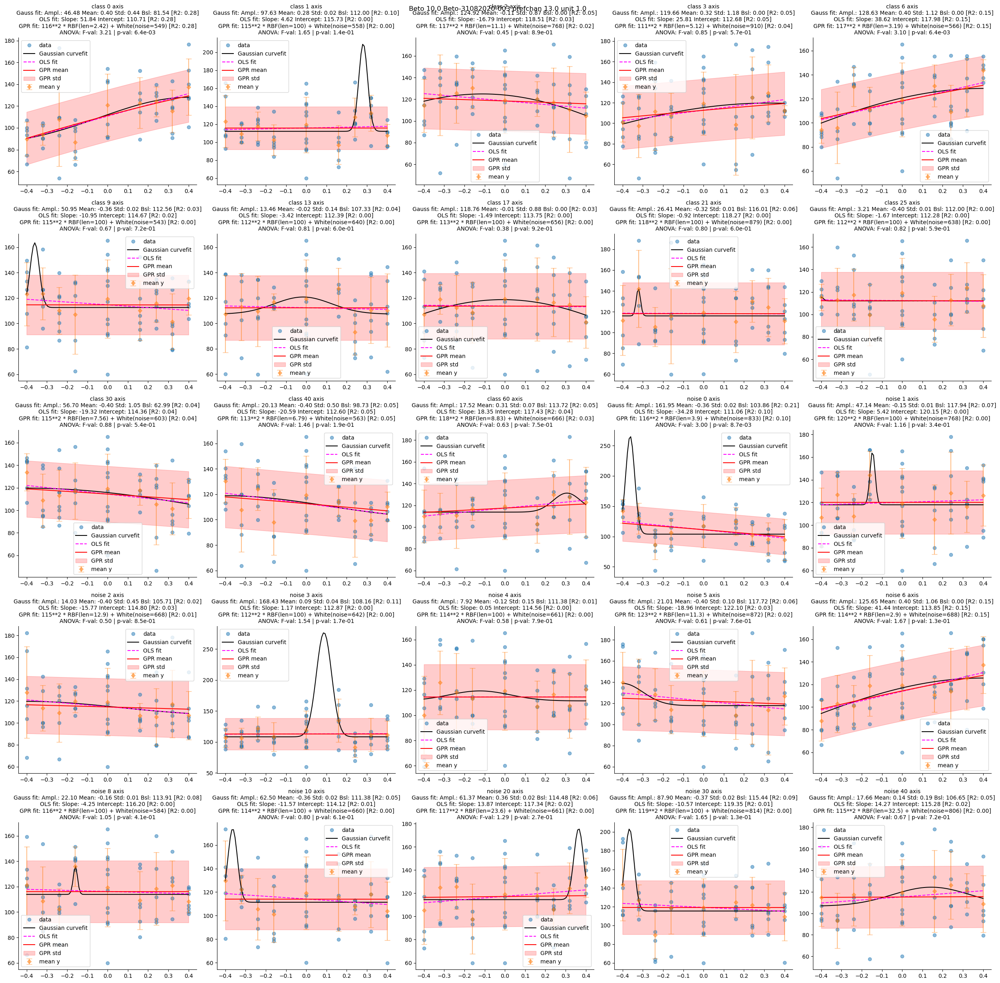

51it [12:35, 41.90s/it]

Processing: row 51 Beto-07092020-003 Beto 11.0
Adding origin trials for class 1
Adding origin trials for class 2
Adding origin trials for class 3
Adding origin trials for class 6
Adding origin trials for class 9
Adding origin trials for class 13
Adding origin trials for class 17
Adding origin trials for class 21
Adding origin trials for class 25
Adding origin trials for class 30
Adding origin trials for class 40
Adding origin trials for class 60
Adding origin trials for noise 1
Adding origin trials for noise 2
Adding origin trials for noise 3
Adding origin trials for noise 4
Adding origin trials for noise 5
Adding origin trials for noise 6
Adding origin trials for noise 8
Adding origin trials for noise 10
Adding origin trials for noise 20
Adding origin trials for noise 30
Adding origin trials for noise 40


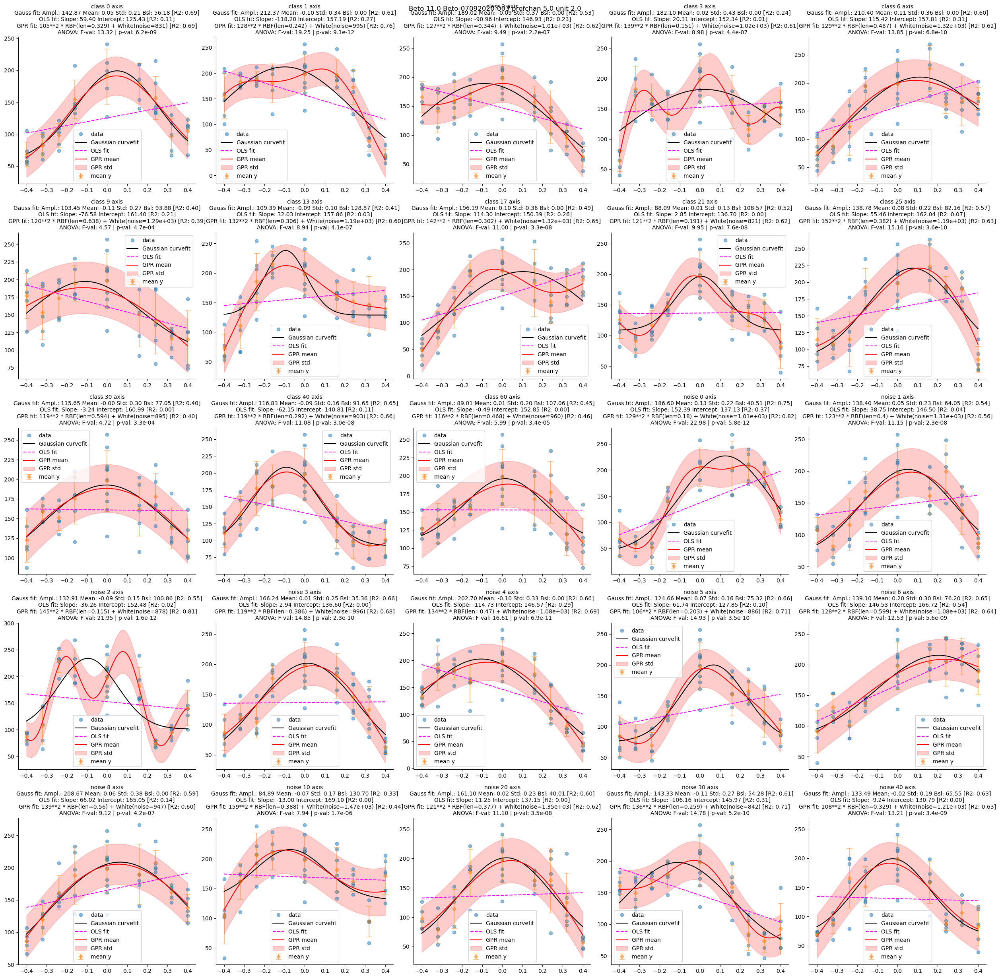

52it [13:14, 40.91s/it]

Processing: row 52 Beto-10092020-003 Beto 12.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

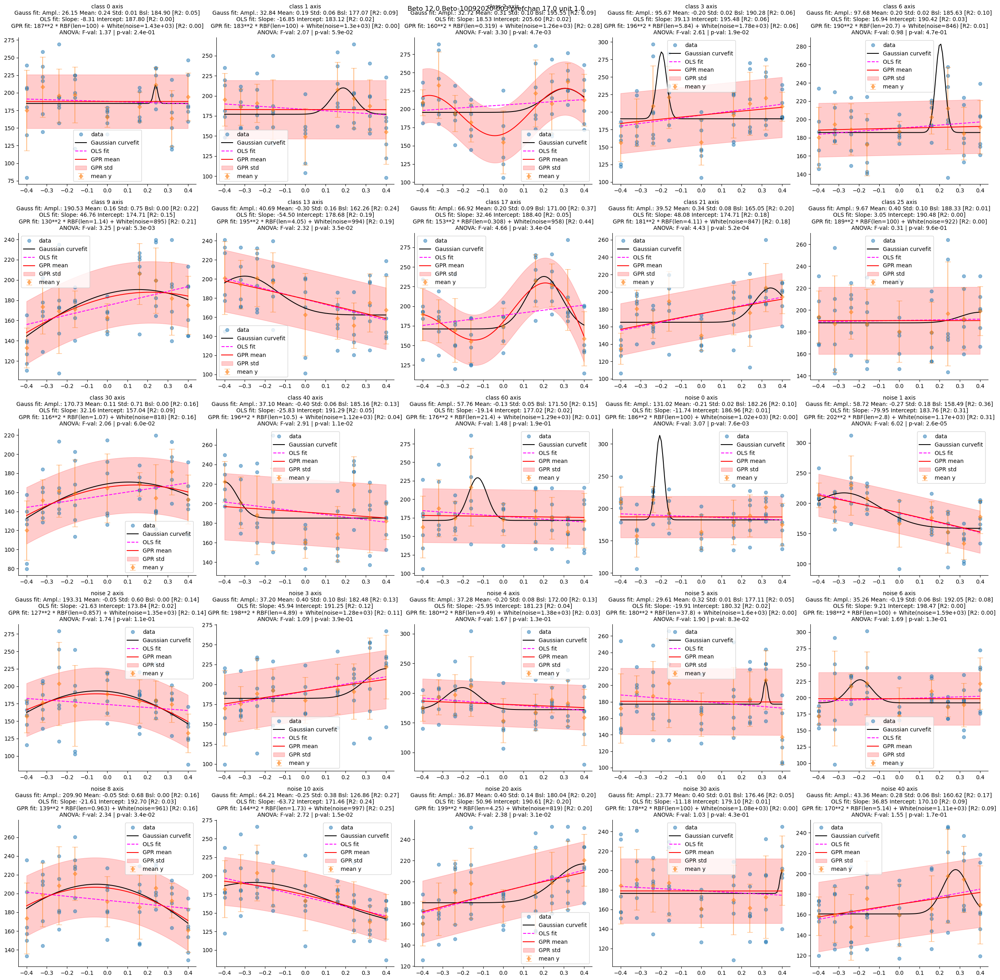

53it [13:54, 40.56s/it]

Processing: row 53 Beto-14092020-004 Beto 13.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

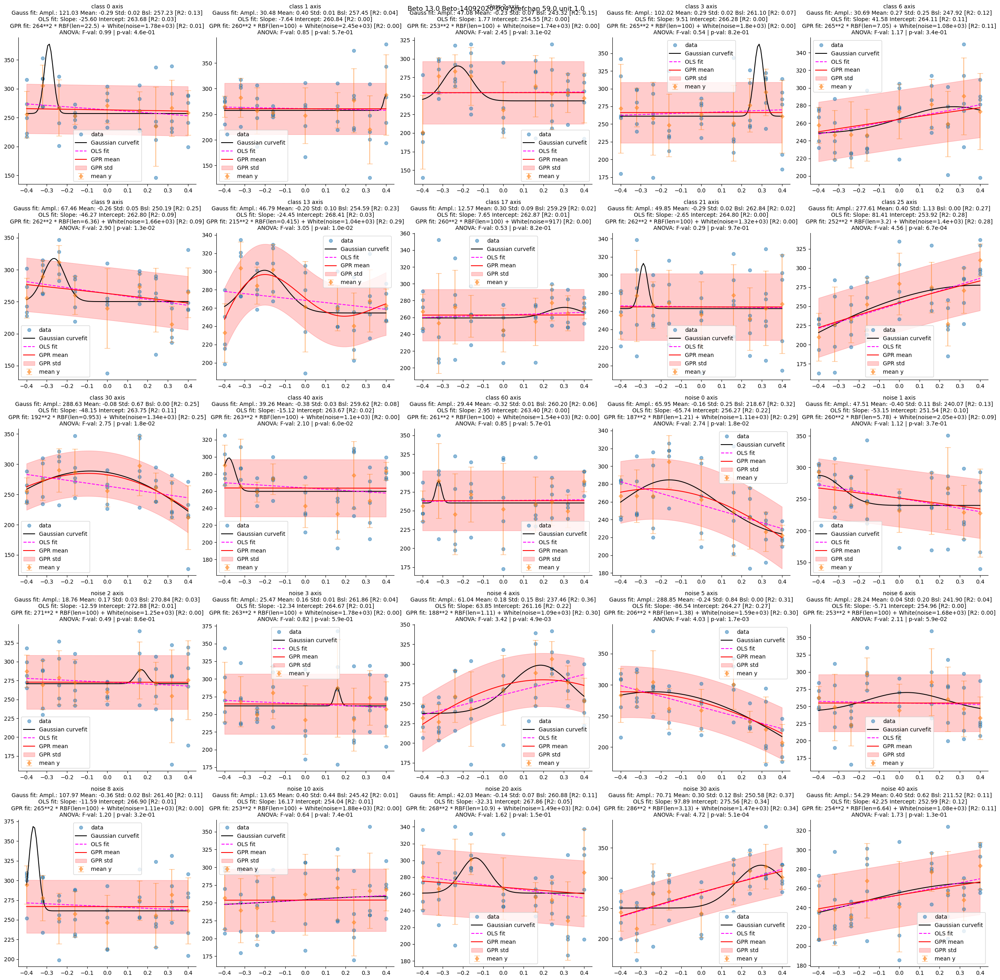

54it [14:32, 39.99s/it]

Processing: row 54 Beto-17092020-003 Beto 14.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


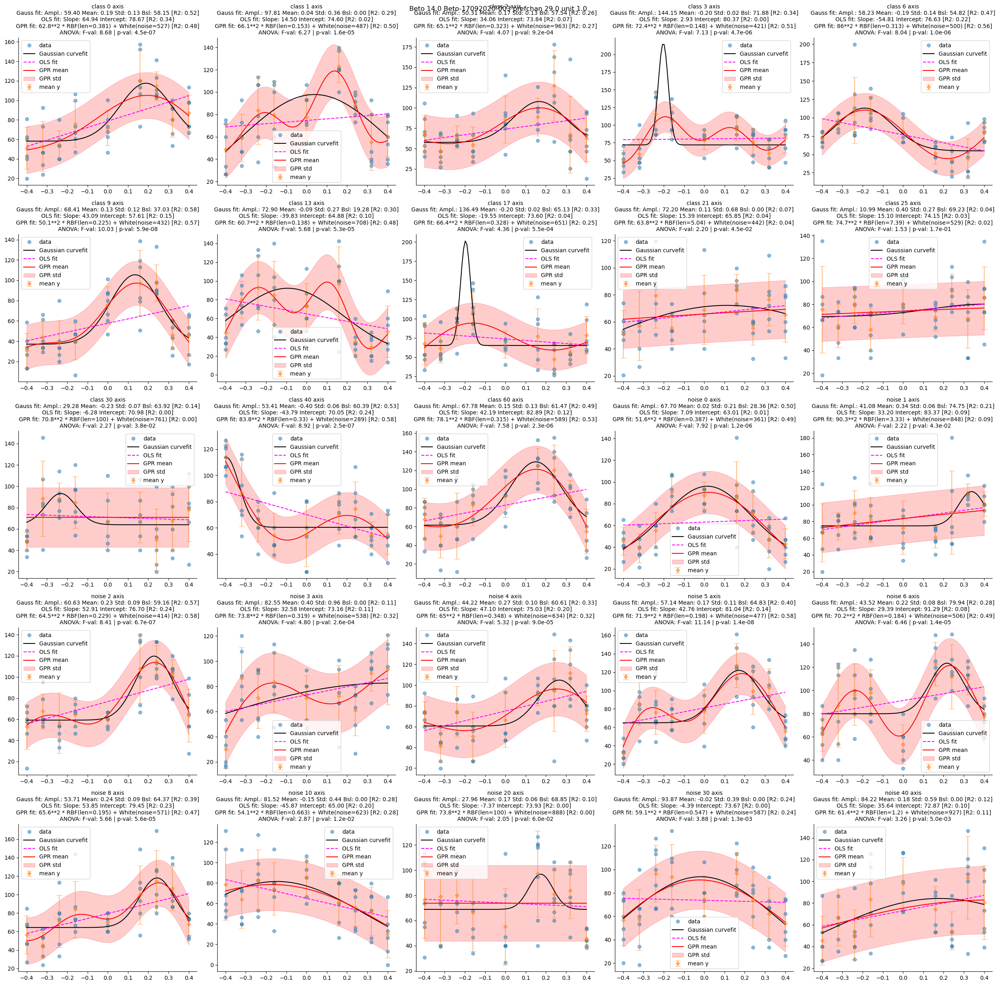

55it [15:11, 16.57s/it]


In [224]:
ExpRecord_Hessian_All = pd.read_csv(r"ExpRecord_BigGAN_Hessian_tuning_ABCD_w_meta.csv")
ExpRecord_Evol_All = pd.read_csv(r"ExpRecord_BigGAN_Hessian_Evol_ABCD_w_meta.csv")
figroot = f"E:\OneDrive - Harvard University\BigGAN_Hessian"
# figdir = join(figroot, "Beto-07092020-003")
# tuning_fitting_stats_synopsis = []
# ExpRecord_Hessian_All = ExpRecord_Hessian_All.sort_values(by=["Animal", "Expi"]).reset_index(drop=True)
for rowi, exprow in tqdm(ExpRecord_Hessian_All.iterrows()):
    if rowi < 33:
        continue
    print("Processing: row", rowi, exprow.ephysFN, exprow.Animal, exprow.Expi)
    figdir = join(figroot, exprow.ephysFN)
    sgtr_resp_df = pd.read_csv(join(figdir, f"single_trial_pref_unit_resp.csv"))
    sgtr_resp_at_origin = sgtr_resp_df.query(f"lin_dist == 0.0") # if some axis does not have origin stats, add it. 
    axis_count = sgtr_resp_df[['space_name', 'eig_id']].drop_duplicates().shape[0]
    tuning_fitting_stats = []
    ncols = 5
    nrows = math.ceil(axis_count / ncols)
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 5, nrows * 5))
    ax_idx = 0
    axs_flatten = axs.flatten()
    for ((space, eig_id), sgtr_resp_per_axis) in sgtr_resp_df.groupby(['space_name', 'eig_id'], sort=True):
        #TODO: if there is not enough data, skip this axis. 
        ax = axs_flatten[ax_idx]
        unique_lin_dist = sgtr_resp_per_axis["lin_dist"].unique()
        if len(unique_lin_dist) < 3:
            continue
        if 0.0 not in unique_lin_dist:
            print(f"Adding origin trials for {space} {eig_id}")
            sgtr_resp_per_axis = pd.concat([sgtr_resp_per_axis, sgtr_resp_at_origin])
        x_values = sgtr_resp_per_axis["lin_dist"].values
        y_values = sgtr_resp_per_axis["pref_unit_resp"].values
        gauss_fit_results = gaussian_curve_fitting(x_values, y_values, visualize=False)
        ols_fit_results = linear_regression_fitting(x_values, y_values, visualize=False)
        gpr_fit_results = gaussian_process_regression(x_values, y_values, visualize=False)
        anova_results = anova_test_df(sgtr_resp_per_axis, x_col="lin_dist", y_col="pref_unit_resp")
        regression_combined_plot(x_values, y_values, gauss_fit_results, ols_fit_results, gpr_fit_results, 
                                    anova_results=anova_results, title_str=f"{space} {eig_id} axis", ax=ax)
        # change the title font size
        ax.set_title(ax.get_title(), fontsize=10)
        fit_bundle = {
            "Animal": exprow.Animal,
            "Expi": exprow.Expi,
            "ephysFN": exprow.ephysFN,
            "space": space,
            "eig_id": eig_id,
            "x_values": x_values,
            "y_values": y_values,
            "gauss_fit_results": gauss_fit_results,
            "ols_fit_results": ols_fit_results,
            "gpr_fit_results": gpr_fit_results,
            "anova_results": anova_results,
        }
        tuning_fitting_stats.append(fit_bundle)
        ax_idx += 1
    # remove the extra axes 
    for ax in axs_flatten[ax_idx:]:
        ax.remove()
    plt.suptitle(f"{exprow.Animal} {exprow.Expi} {exprow.ephysFN} prefchan {exprow.pref_chan} unit {exprow.pref_unit}")
    plt.tight_layout()
    saveallforms(figdir, f"tuning_shape_fitting_comparison", fig, ["png", "pdf"])
    plt.show()
    pkl.dump(tuning_fitting_stats, open(join(figdir, f"tuning_fitting_stats.pkl"), "wb"))


In [223]:
x_values = sgtr_resp_per_axis["lin_dist"].values
y_values = sgtr_resp_per_axis["pref_unit_resp"].values
gauss_fit_results = gaussian_curve_fitting(x_values, y_values, visualize=False)
ols_fit_results = linear_regression_fitting(x_values, y_values, visualize=False)
gpr_fit_results = gaussian_process_regression(x_values, y_values, visualize=False)
anova_results = anova_test_df(sgtr_resp_per_axis, x_col="lin_dist", y_col="pref_unit_resp")

Error performing ANOVA : r_matrix performs f_test for using dimensions that are asymptotically non-normal


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\statsmodels\regression\linear_model.py:1716: RuntimeWarning: divide by zero encountered in scalar divide
  return np.dot(wresid, wresid) / self.df_resid


In [220]:
x_values

array([-0.32, -0.4 , -0.24,  0.24,  0.32,  0.  ,  0.4 , -0.16,  0.16])

0it [00:00, ?it/s]

Processing: row 0 Caos-12022024-003 Caos 1.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "


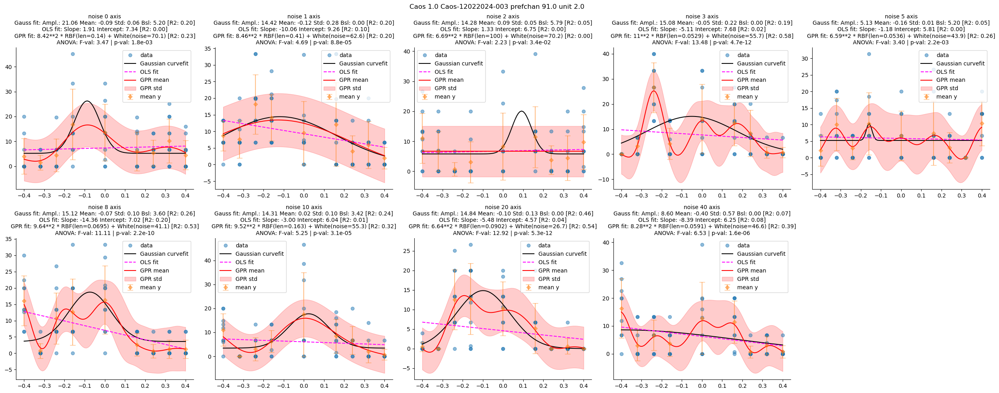

1it [00:12, 12.51s/it]

Processing: row 1 Caos-12022024-006 Caos 2.0


c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn("The optimal value found for "
c:\Users\ponce\.conda\envs\torch\lib\site-packages\sklearn\gaussian_process\kernels.py:411: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warning

KeyboardInterrupt: 

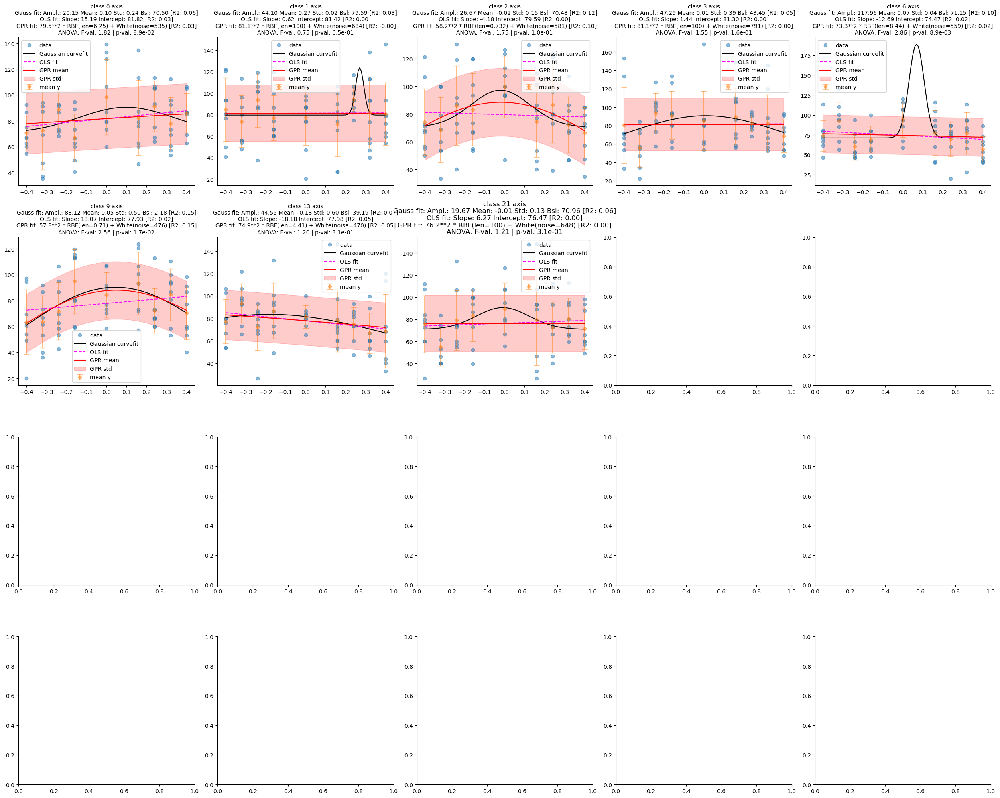

In [214]:
ExpRecord_Hessian_All = pd.read_csv(r"ExpRecord_BigGAN_Hessian_tuning_ABCD_w_meta.csv")
ExpRecord_Evol_All = pd.read_csv(r"ExpRecord_BigGAN_Hessian_Evol_ABCD_w_meta.csv")
figroot = f"E:\OneDrive - Harvard University\BigGAN_Hessian"
# figdir = join(figroot, "Beto-07092020-003")
tuning_fitting_stats_synopsis = []
# ExpRecord_Hessian_All = ExpRecord_Hessian_All.sort_values(by=["Animal", "Expi"]).reset_index(drop=True)
for rowi, exprow in tqdm(ExpRecord_Hessian_All.iterrows()):
    print("Processing: row", rowi, exprow.ephysFN, exprow.Animal, exprow.Expi)
    figdir = join(figroot, exprow.ephysFN)
    sgtr_resp_df = pd.read_csv(join(figdir, f"single_trial_pref_unit_resp.csv"))
    sgtr_resp_at_origin = sgtr_resp_df.query(f"lin_dist == 0.0") # if some axis does not have origin stats, add it. 
    axis_count = sgtr_resp_df[['space_name', 'eig_id']].drop_duplicates().shape[0]
    tuning_fitting_stats = []
    ncols = 5
    nrows = math.ceil(axis_count / ncols)
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 5, nrows * 5))
    ax_idx = 0
    axs_flatten = axs.flatten()
    for ((space, eig_id), sgtr_resp_per_axis) in sgtr_resp_df.groupby(['space_name', 'eig_id'], sort=True):
        #TODO: if there is not enough data, skip this axis. 
        ax = axs_flatten[ax_idx]
        unique_lin_dist = sgtr_resp_per_axis["lin_dist"].unique()
        if len(unique_lin_dist) < 3:
            continue
        if 0.0 not in unique_lin_dist:
            print(f"Adding origin trials for {space} {eig_id}")
            sgtr_resp_per_axis = pd.concat([sgtr_resp_per_axis, sgtr_resp_at_origin])
        x_values = sgtr_resp_per_axis["lin_dist"].values
        y_values = sgtr_resp_per_axis["pref_unit_resp"].values
        gauss_fit_results = gaussian_curve_fitting(x_values, y_values, visualize=False)
        ols_fit_results = linear_regression_fitting(x_values, y_values, visualize=False)
        gpr_fit_results = gaussian_process_regression(x_values, y_values, visualize=False)
        anova_results = anova_test_df(sgtr_resp_per_axis, x_col="lin_dist", y_col="pref_unit_resp")
        regression_combined_plot(x_values, y_values, gauss_fit_results, ols_fit_results, gpr_fit_results, 
                                    anova_results=anova_results, title_str=f"{space} {eig_id} axis", ax=ax)
        # change the title font size
        ax.set_title(ax.get_title(), fontsize=10)
        fit_bundle = {
            "Animal": exprow.Animal,
            "Expi": exprow.Expi,
            "ephysFN": exprow.ephysFN,
            "space": space,
            "eig_id": eig_id,
            "x_values": x_values,
            "y_values": y_values,
            "gauss_fit_results": gauss_fit_results,
            "ols_fit_results": ols_fit_results,
            "gpr_fit_results": gpr_fit_results,
            "anova_results": anova_results,
        }
        tuning_fitting_stats.append(fit_bundle)
        ax_idx += 1
    # remove the extra axes 
    for ax in axs_flatten[ax_idx:]:
        ax.remove()
    plt.suptitle(f"{exprow.Animal} {exprow.Expi} {exprow.ephysFN} prefchan {exprow.pref_chan} unit {exprow.pref_unit}")
    plt.tight_layout()
    saveallforms(figdir, f"tuning_shape_fitting_comparison", fig, ["png", "pdf"])
    plt.show()
    pkl.dump(tuning_fitting_stats, open(join(figdir, f"tuning_fitting_stats.pkl"), "wb"))
    tuning_fitting_stats_synopsis.extend(tuning_fitting_stats)
pkl.dump(tuning_fitting_stats_synopsis, open(join(figroot, f"tuning_fitting_stats_synopsis.pkl"), "wb"))

In [187]:
x_values

array([-0.32, -0.4 , -0.24,  0.24,  0.32,  0.  ,  0.4 , -0.16,  0.16])

In [188]:
y_values


array([59.93854 , 39.973812, 59.93855 , 53.278717, 63.933353, 63.918587,
       33.299202, 47.303776, 39.90061 ])